데이터셋 기본 로드

In [1]:
import pandas as pd
import os

df = pd.read_csv('data/trainLabels.csv')

# 이미지 경로 붙이기
df['image_path'] = df['image'].apply(
    lambda x: os.path.join('data/images/train', x + '.jpeg')
)

print(df.head())
print(df['level'].value_counts())

      image  level                       image_path
0   10_left      0   data/images/train\10_left.jpeg
1  10_right      0  data/images/train\10_right.jpeg
2   13_left      0   data/images/train\13_left.jpeg
3  13_right      0  data/images/train\13_right.jpeg
4   15_left      1   data/images/train\15_left.jpeg
level
0    25810
2     5292
1     2443
3      873
4      708
Name: count, dtype: int64


In [4]:
df.count()

image         35126
level         35126
image_path    35126
dtype: int64

클래스 불균형 분포 확인

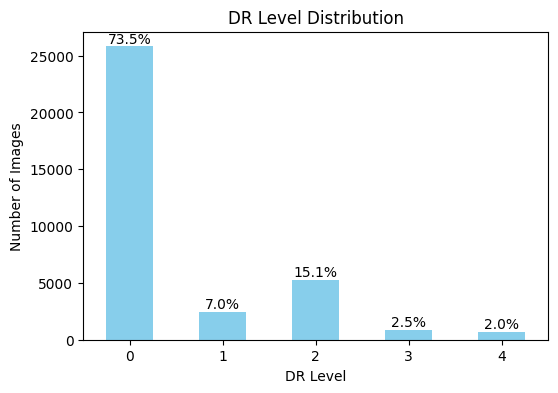

In [2]:
import matplotlib.pyplot as plt

counts = df['level'].value_counts().sort_index()
percentages = counts / counts.sum() * 100

plt.figure(figsize=(6,4))
counts.plot(kind='bar', color='skyblue')
for idx, value in enumerate(percentages):
    plt.text(idx, counts.iloc[idx]+300, f"{value:.1f}%", ha='center')
plt.title('DR Level Distribution')
plt.xlabel('DR Level')
plt.ylabel('Number of Images')
plt.xticks(rotation=0)
plt.show()

샘플 이미지 확인

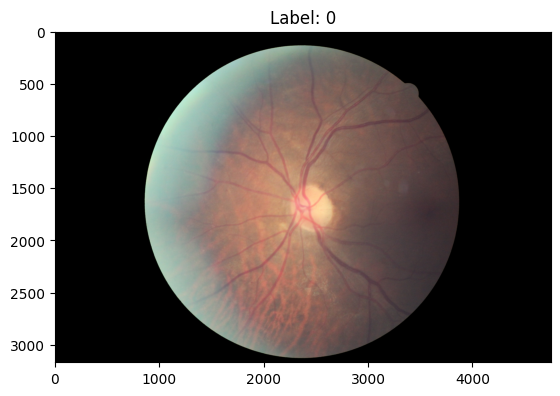

In [3]:
import matplotlib.pyplot as plt
from PIL import Image

img = Image.open(df['image_path'].iloc[0])
plt.imshow(img)
plt.title(f"Label: {df['level'].iloc[0]}")
plt.show()

이미지 크기 분포 확인

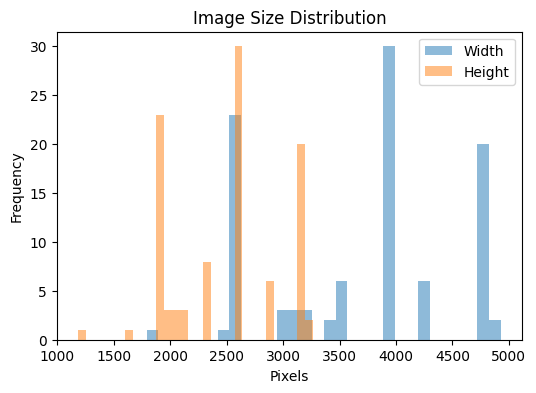

In [4]:
import numpy as np

widths, heights = [], []

for path in df['image_path'].sample(100):
    img = Image.open(path)
    widths.append(img.size[0])
    heights.append(img.size[1])

plt.figure(figsize=(6,4))
plt.hist(widths, bins=30, alpha=0.5, label='Width')
plt.hist(heights, bins=30, alpha=0.5, label='Height')
plt.title('Image Size Distribution')
plt.xlabel('Pixels')
plt.ylabel('Frequency')
plt.legend()
plt.show()

이미지 품질 이슈 확인

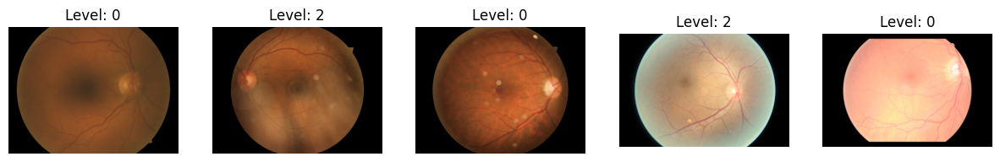

In [5]:
n = 5
sample_df = df.sample(n)

fig, axes = plt.subplots(1, n, figsize=(15,5))
for i, row in enumerate(sample_df.itertuples()):
    img = Image.open(row.image_path)
    axes[i].imshow(img)
    axes[i].set_title(f"Level: {row.level}")
    axes[i].axis('off')
plt.show()

In [6]:
import numpy as np
from PIL import Image
import hashlib
import os

# 이상치 리스트 담을 컬럼
df['resolution_outlier'] = False
df['pixel_outlier'] = False
df['broken'] = False
df['duplicate'] = False
df['label_outlier'] = False

해상도 기준 이상치

In [7]:
resolution_outliers = []

for idx, path in enumerate(df['image_path']):
    try:
        img = Image.open(path)
        w, h = img.size
        if w < 1000 or h < 1000:   # 기준값 예시
            df.loc[idx, 'resolution_outlier'] = True
    except:
        pass

픽셀 평균/표준편차 이상치

In [8]:
pixel_outliers = []

for idx, path in enumerate(df['image_path']):
    try:
        img = Image.open(path).convert('L')
        arr = np.array(img) / 255.0
        mean = arr.mean()
        std = arr.std()

        if mean < 0.05 or mean > 0.95 or std < 0.01:
            df.loc[idx, 'pixel_outlier'] = True

    except:
        pass

In [12]:
df[df['pixel_outlier'] == True].head()

,image,level,image_path,resolution_outlier,pixel_outlier,broken,duplicate,label_outlier
462,551_left,0,data/images/train\551_left.jpeg,False,True,False,False,False
546,669_left,0,data/images/train\669_left.jpeg,False,True,False,False,False
632,766_left,1,data/images/train\766_left.jpeg,False,True,False,False,False
872,1051_left,0,data/images/train\1051_left.jpeg,False,True,False,False,False
972,1178_left,2,data/images/train\1178_left.jpeg,False,True,False,False,False


파일 손상 확인

In [13]:
for idx, path in enumerate(df['image_path']):
    try:
        img = Image.open(path)
        img.verify()  # 실제 손상 여부
    except:
        df.loc[idx, 'broken'] = True

In [14]:
df['broken'].value_counts()

broken
False    35126
Name: count, dtype: int64

중복 파일 확인

In [15]:
hashes = []

for path in df['image_path']:
    try:
        with open(path, 'rb') as f:
            file_hash = hashlib.md5(f.read()).hexdigest()
            hashes.append(file_hash)
    except:
        hashes.append(None)

df['file_hash'] = hashes

# 중복 여부 표시
duplicates = df[df['file_hash'].duplicated(keep=False)]
df.loc[duplicates.index, 'duplicate'] = True

레벨 이상치 탐지

In [18]:
df['label_outlier'] = ~df['level'].isin([0, 1, 2, 3, 4])

In [19]:
# 이상치 조건 하나라도 True인 경우
df['is_outlier'] = df[['resolution_outlier', 'pixel_outlier', 'broken', 'duplicate', 'label_outlier']].any(axis=1)

outliers = df[df['is_outlier']]
print(f"이상치 후보 개수: {len(outliers)}")

# CSV로 저장
outliers.to_csv('outliers_candidates.csv', index=False)

# 이상치 제외 클린 데이터셋 저장
df_clean = df[~df['is_outlier']]
df_clean.to_csv('train_clean.csv', index=False)

df.to_csv('train.csv',index=False)

이상치 후보 개수: 173


### **이상치 유형별 도메인 지식 기반 분석 및 처리 전략**

> 의료 AI에서 이상치로 보이는 데이터는 실제 질병의 중요한 특징일 수 있으므로, 무조건적인 제거는 모델 성능에 부정적 영향을 미칠 수 있음 따라서 각 이상치 유형을 도메인 지식에 근거하여 신중하게 처리

---

| 이상치 유형 | 도메인 관점 해석 | 추천 처리 전략 |
| :--- | :--- | :--- |
| **해상도 이상치** | **이미징 품질 문제**: 저해상도 이미지는 당뇨망막병증의 핵심 특징인 미세혈관류, 출혈, 삼출물 등의 관찰을 어렵게 만듬 | **제거 권장**: 정보 손실 및 노이즈 증가를 방지하여 모델 성능을 높임 |
| **픽셀 분포 이상치** | **촬영 오류 또는 질병 특징**: <br> - **어두운 이미지**: 노출 부족(오류) 또는 심각한 단계의 초자체 출혈(질병 특징)일 수 있음 <br> - **밝은 이미지**: 과다 노출(오류) 또는 다량의 경성 삼출물(질병 특징)일 수 있음 <br> - **저대비 이미지**: 초점 불량(오류) 또는 백내장(질병 관련 특징)일 수 있음 | **수동 검토 필수**: <br> - **질병 특징인 경우**: 반드시 학습 데이터에 **포함** <br> - **명백한 촬영 오류인 경우**: 학습에 방해가 되므로 **제거** <br> - **판독 불가 수준인 경우**: 별도 클래스로 분류하거나 학습에서 **제외**하는 것을 고려 |
| **중복 파일** | **데이터 관리 오류**: 동일한 이미지 파일이 다른 이름으로 여러 번 포함된 경우 | **중복 제거**: 특정 이미지에 대한 모델의 과적합을 방지하기 위해 하나만 남기고 제거 |
| **레이블 이상치** | **라벨링 오류**: 정의된 단계(0~4)를 벗어나는 값은 명백한 데이터 입력 오류 | **즉시 제거**: 모델 학습에 사용할 수 없는 데이터 |

---

### **다음 단계 제안**

1.  **이상치 후보 수동 검토**: 식별된 이상치 후보, 특히 '픽셀 분포 이상치'를 직접 검토하여 최종적으로 학습에 사용할 데이터를 확정
2.  **'판독 불가' 클래스 도입 고려**: 백내장이나 심한 촬영 오류 등으로 판독이 어려운 이미지가 많을 경우, 이를 별도의 클래스로 정의하여 모델의 현실적인 진단 능력을 향상시킬 수 있음

총 173개의 이상치 후보를 검토합니다.


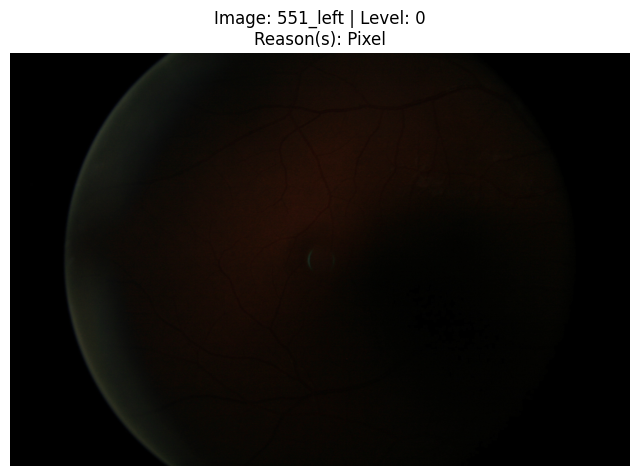

----------------------------------------


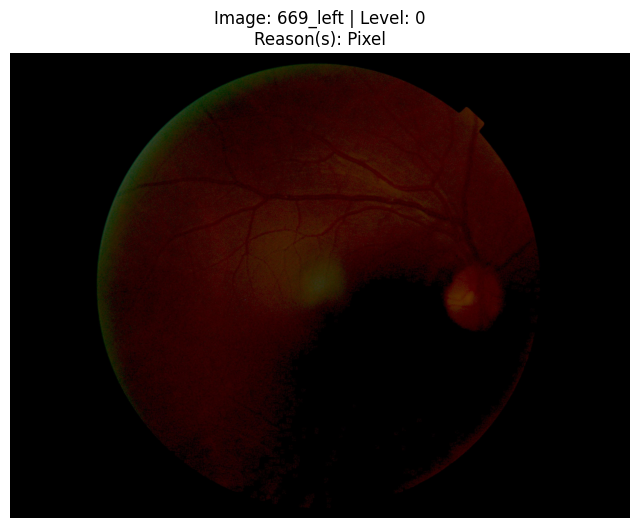

----------------------------------------


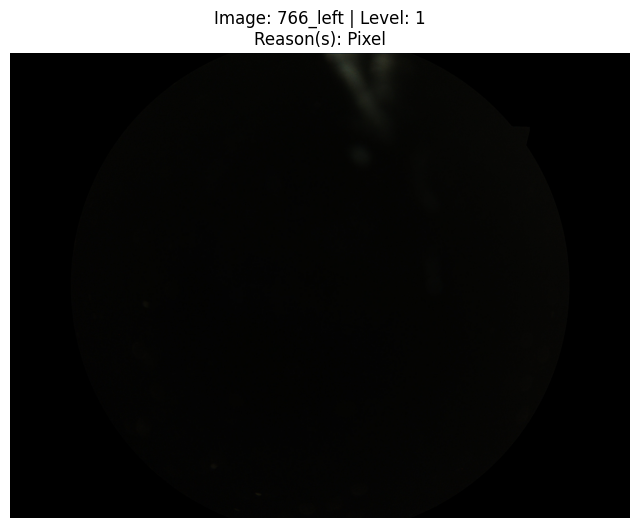

----------------------------------------


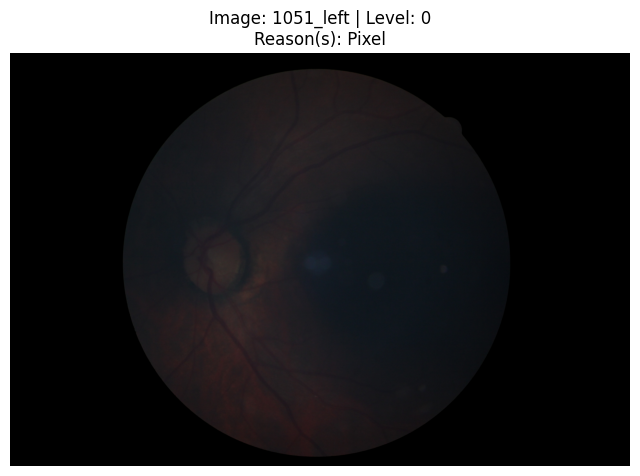

----------------------------------------


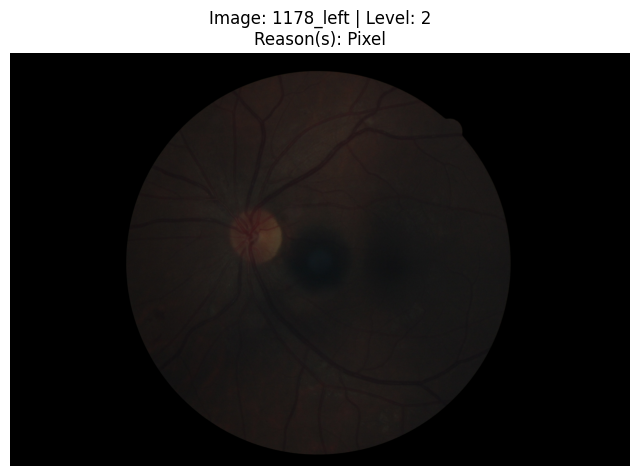

----------------------------------------


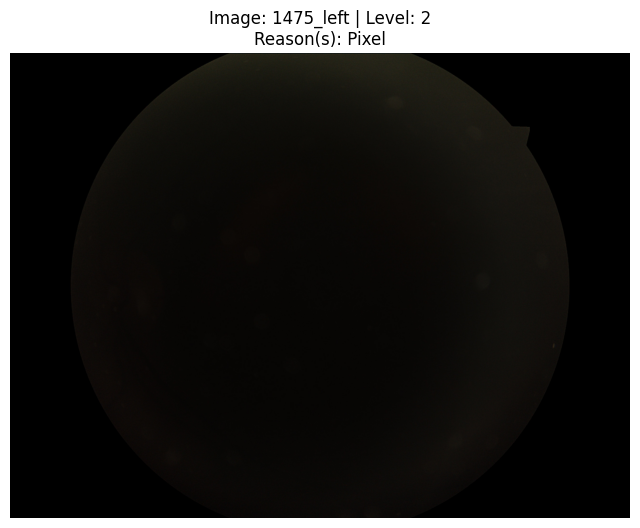

----------------------------------------


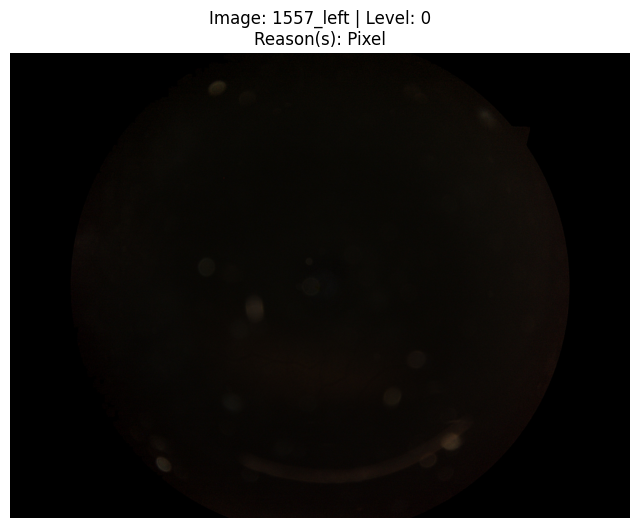

----------------------------------------


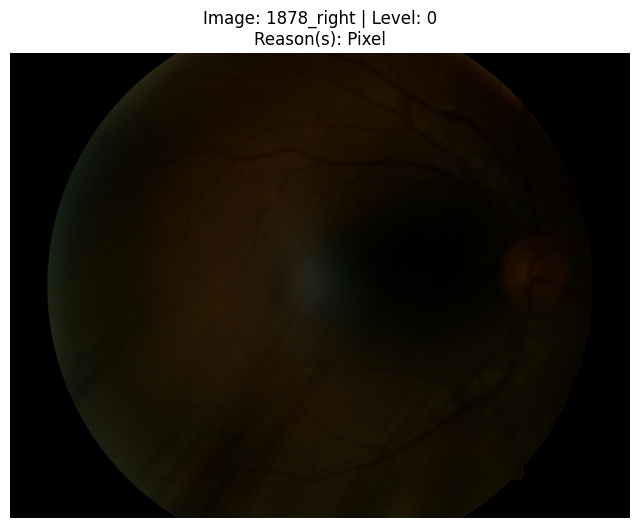

----------------------------------------


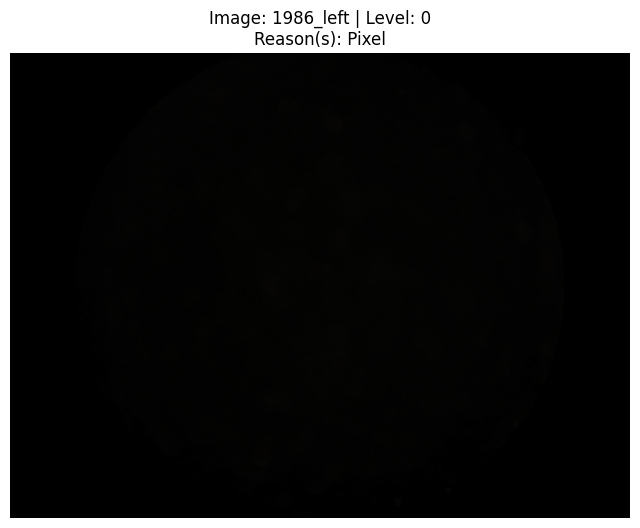

----------------------------------------


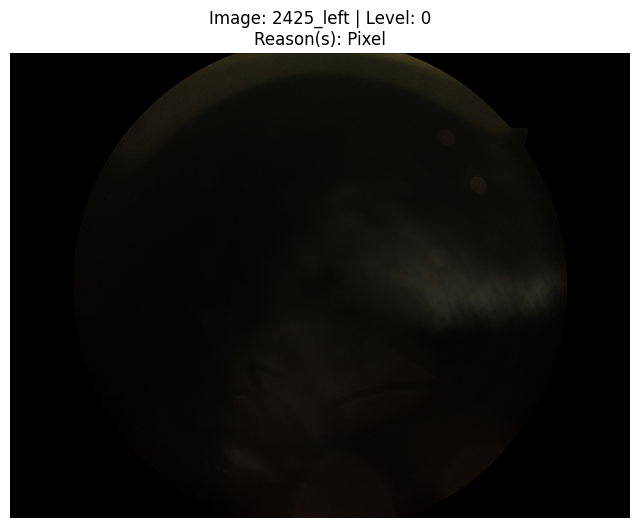

----------------------------------------


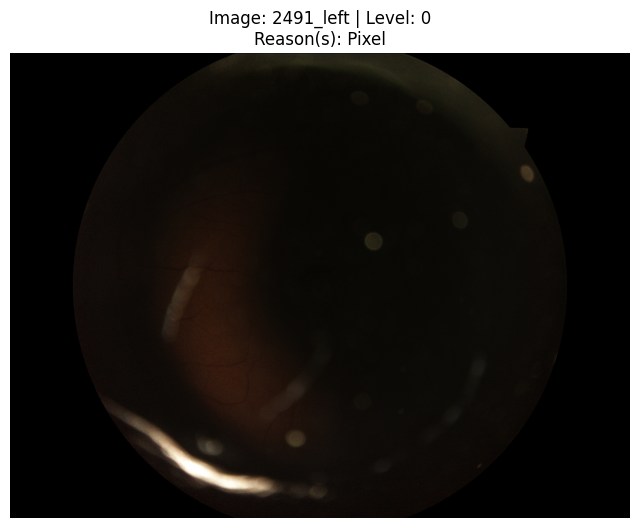

----------------------------------------


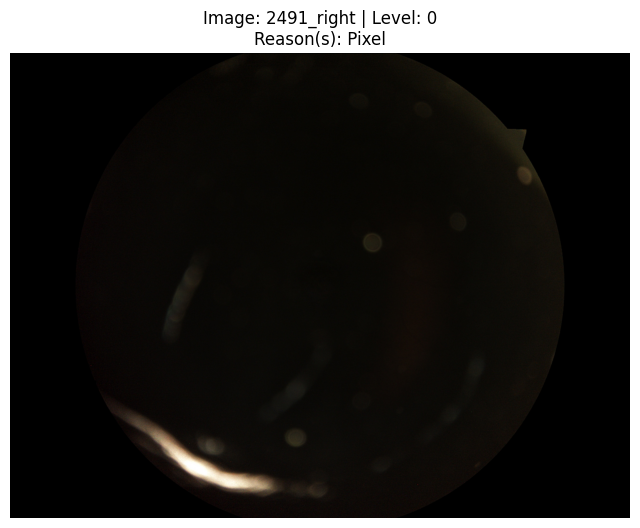

잘못된 입력입니다. k, d, u, q 중 하나를 입력하세요.
잘못된 입력입니다. k, d, u, q 중 하나를 입력하세요.
----------------------------------------


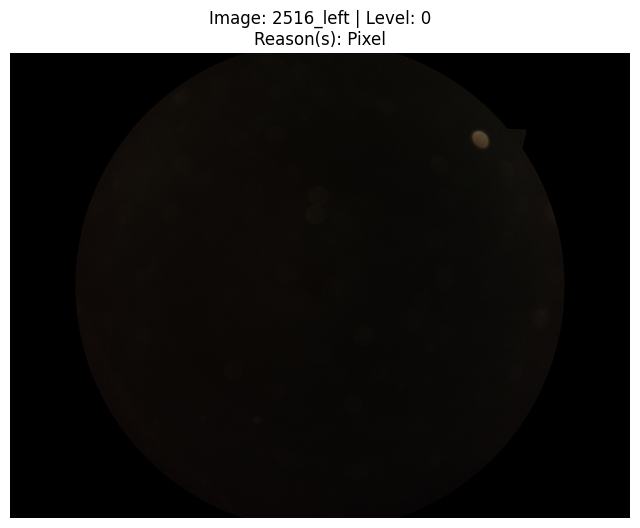

----------------------------------------


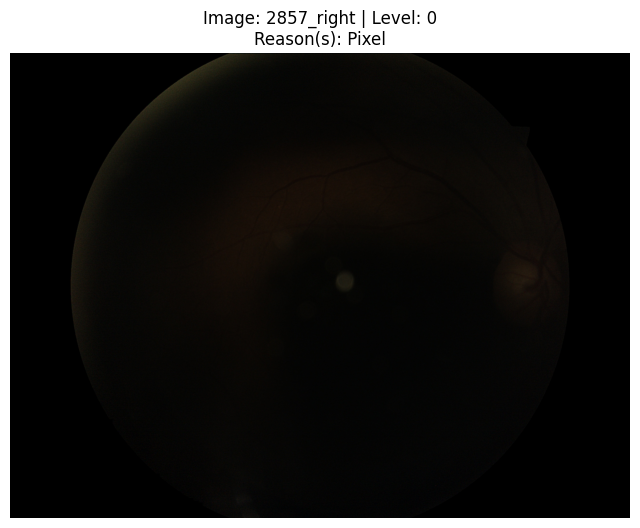

----------------------------------------


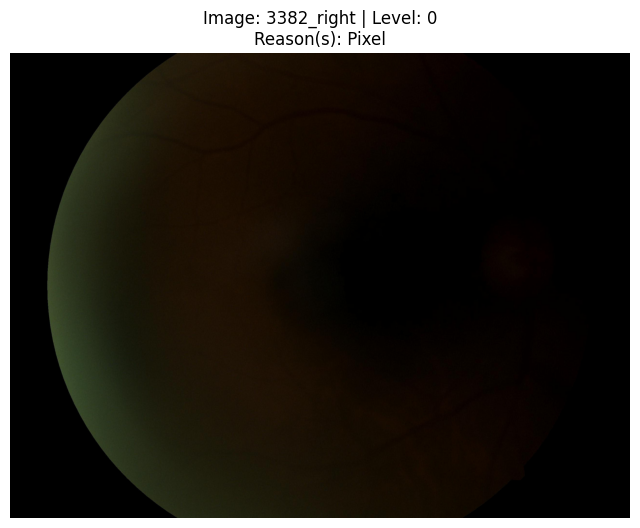

----------------------------------------


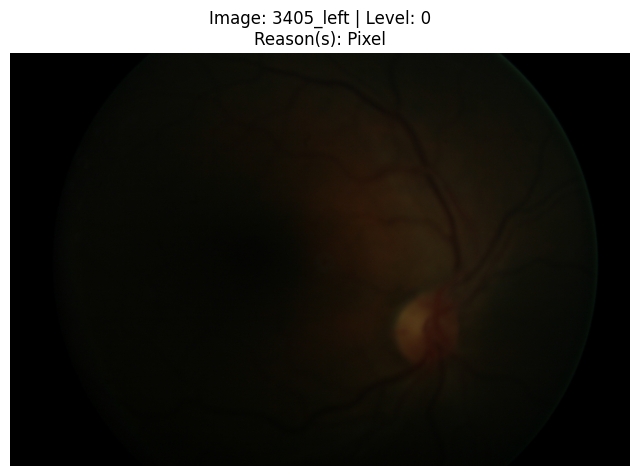

----------------------------------------


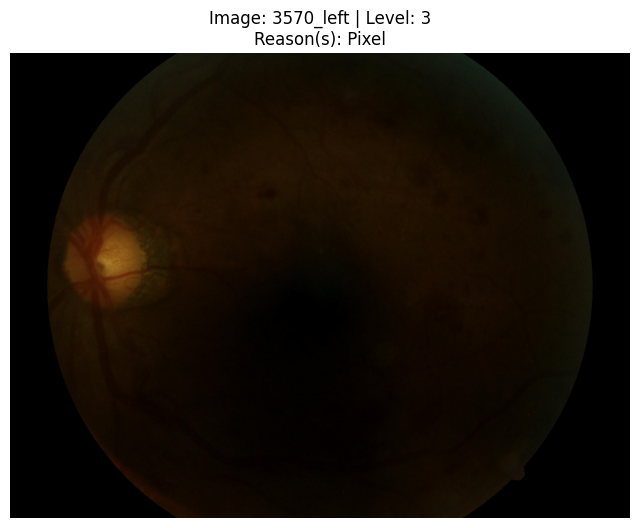

----------------------------------------


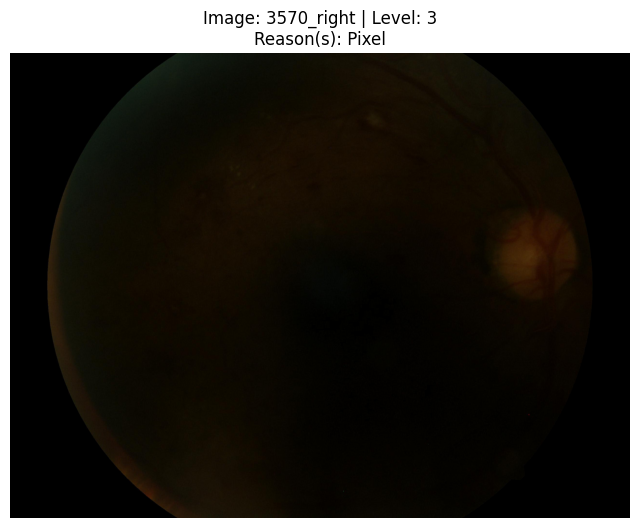

----------------------------------------


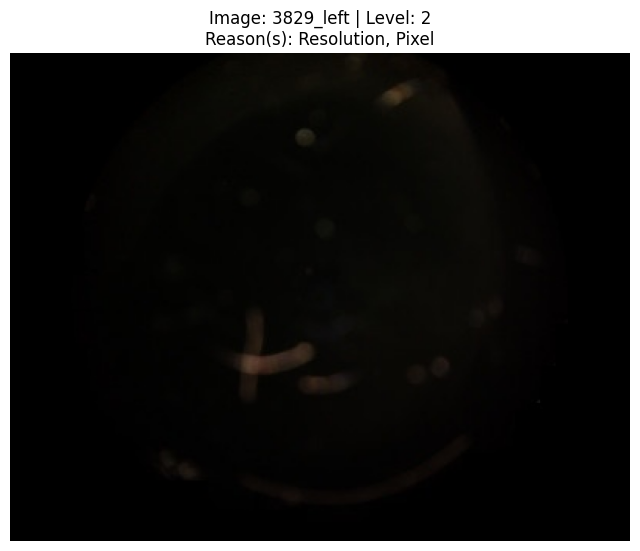

----------------------------------------


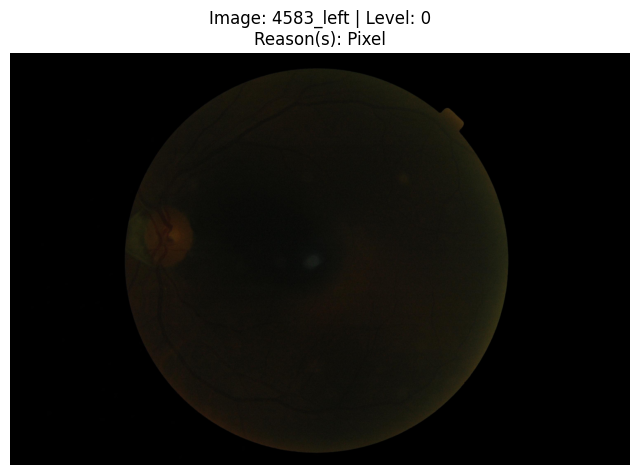

----------------------------------------


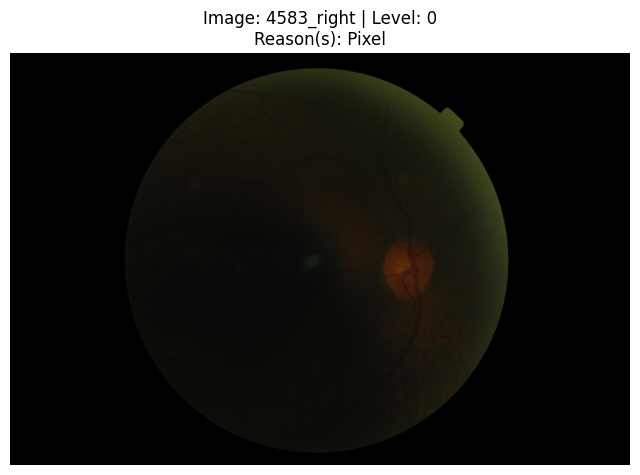

----------------------------------------


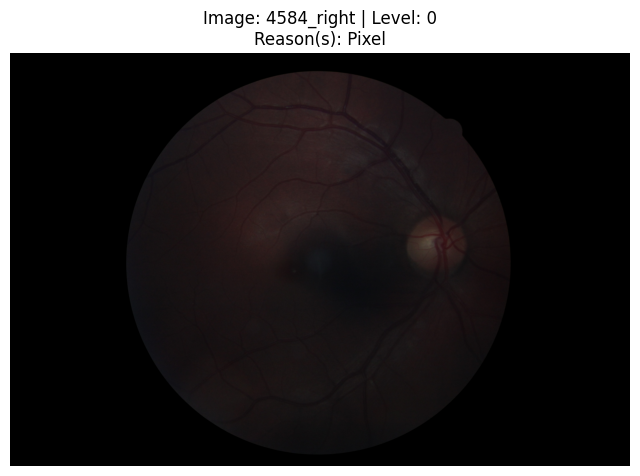

----------------------------------------


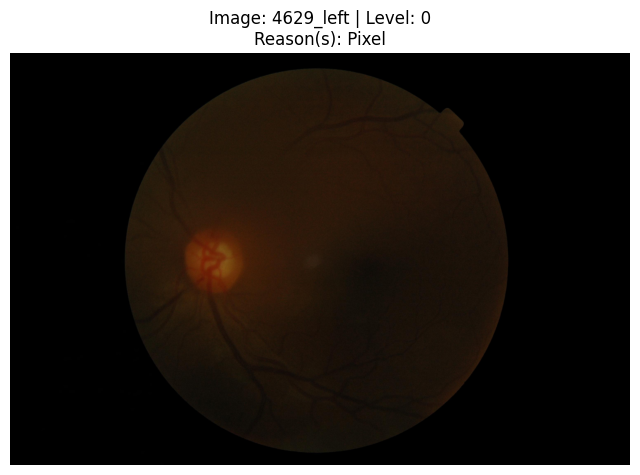

----------------------------------------


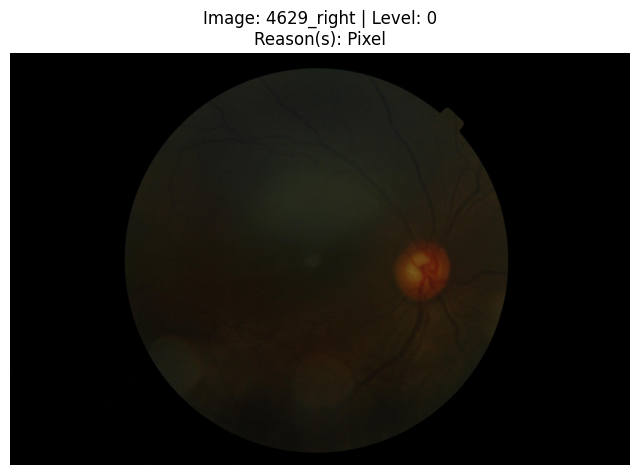

----------------------------------------


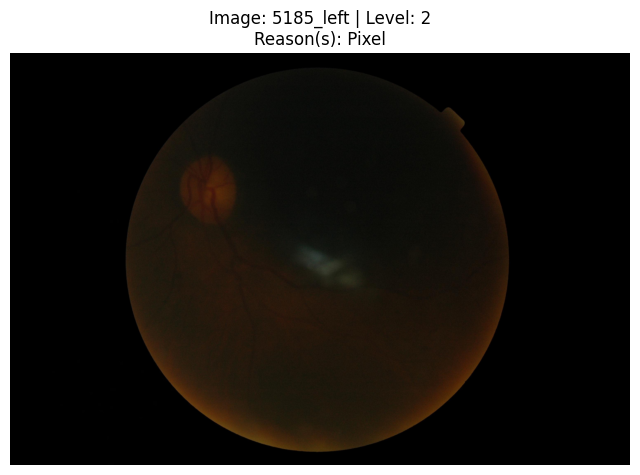

----------------------------------------


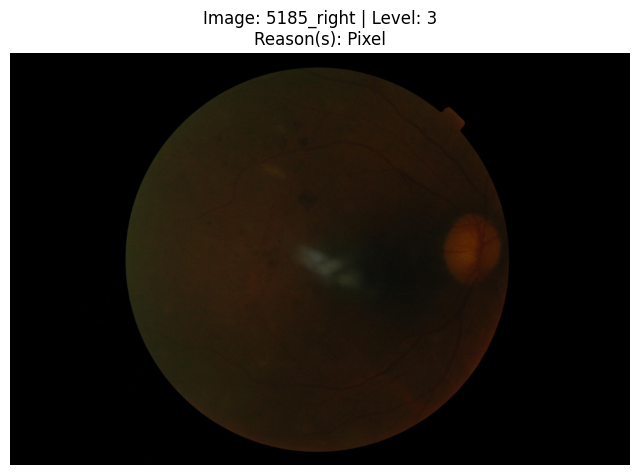

----------------------------------------


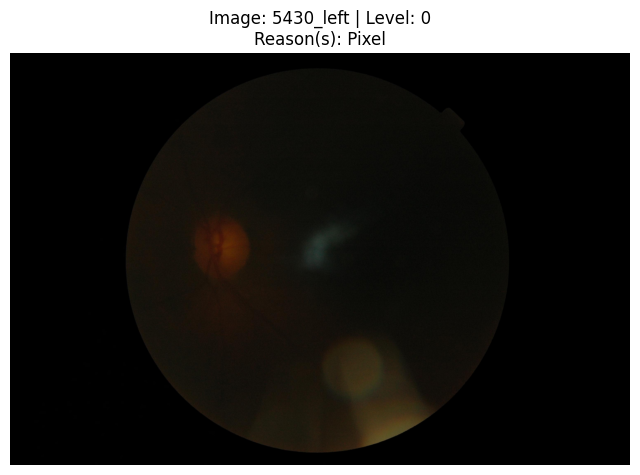

----------------------------------------


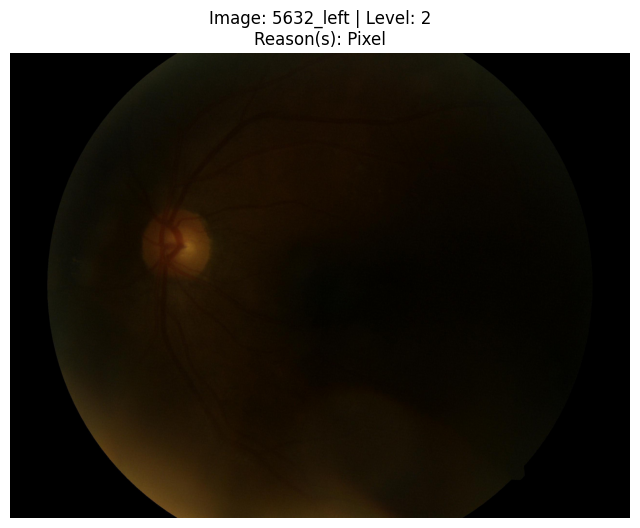

----------------------------------------


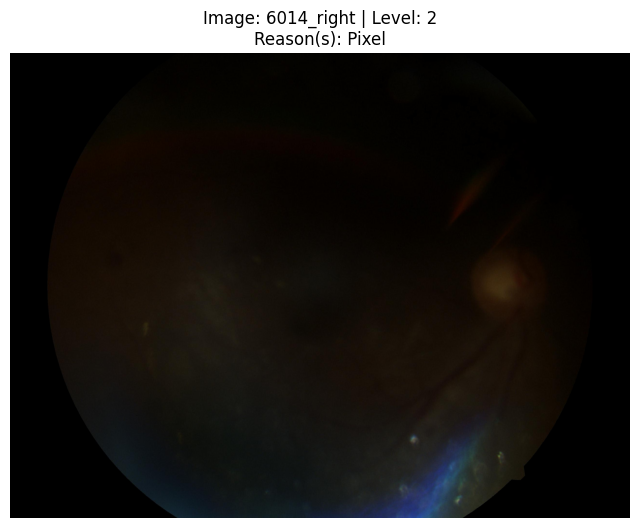

----------------------------------------


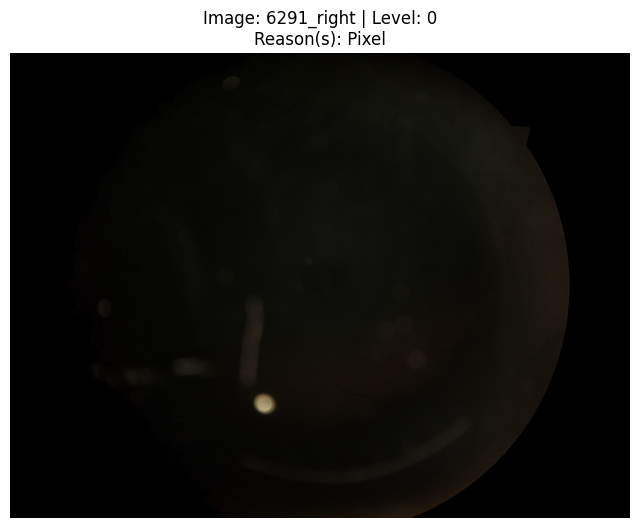

----------------------------------------


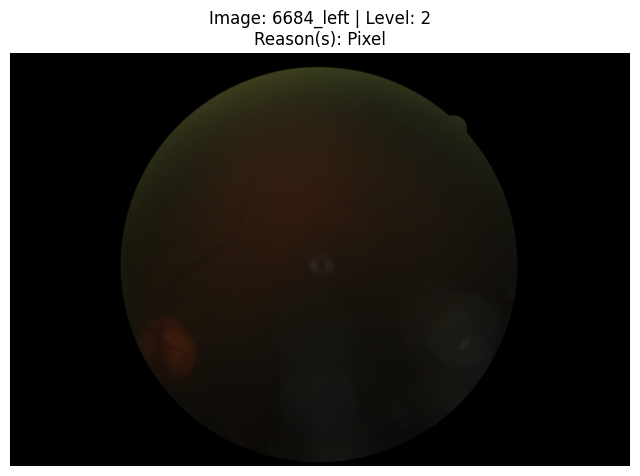

----------------------------------------


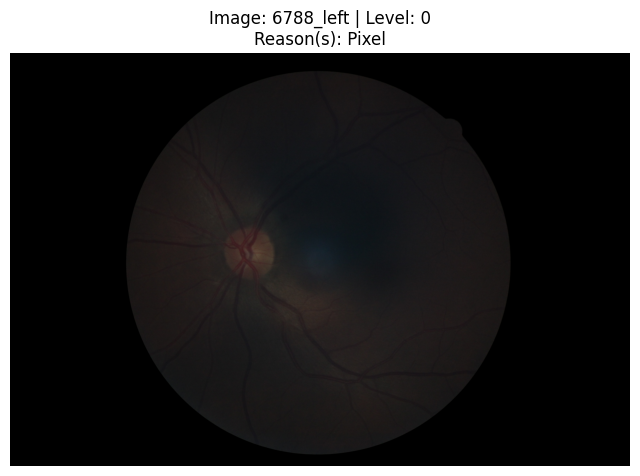

----------------------------------------


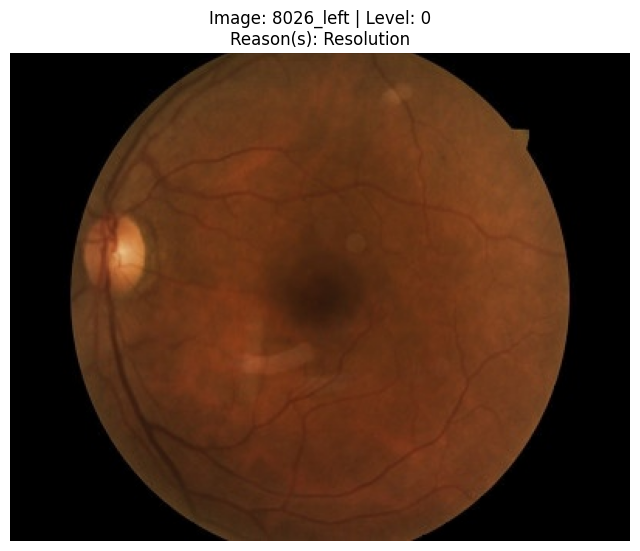

----------------------------------------


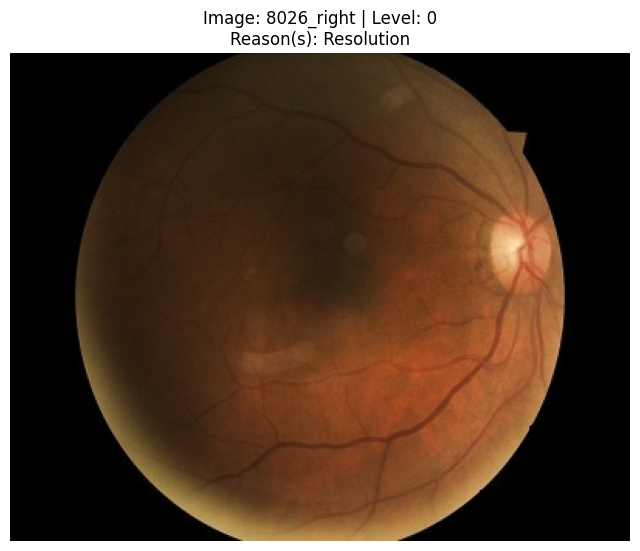

----------------------------------------


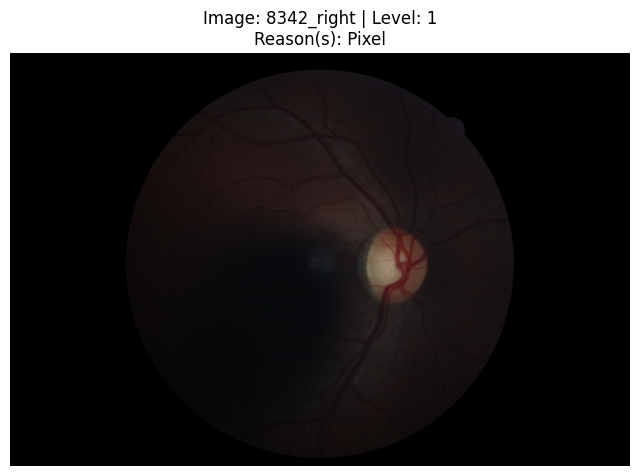

----------------------------------------


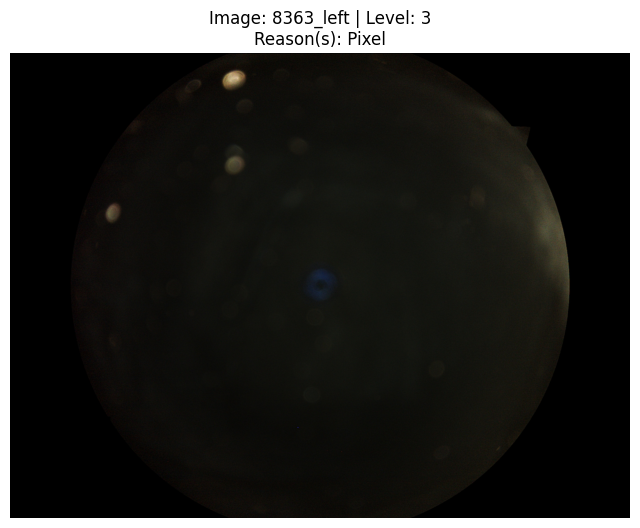

----------------------------------------


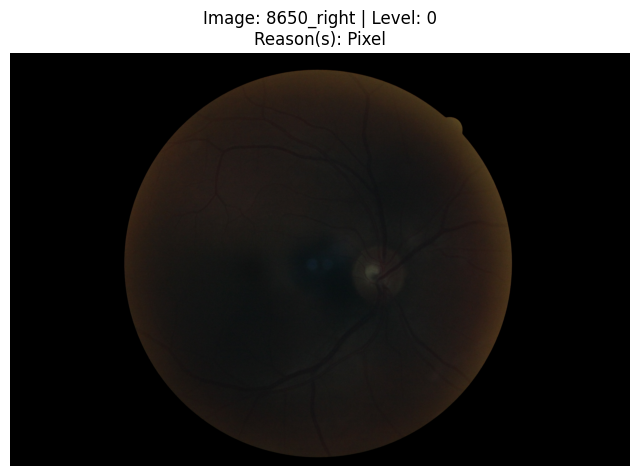

----------------------------------------


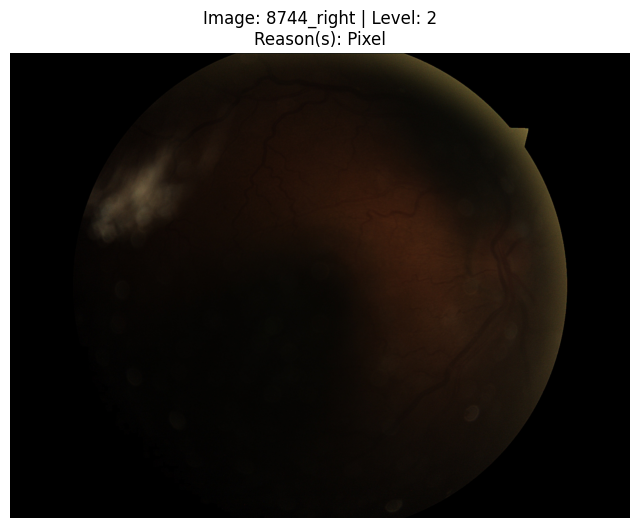

----------------------------------------


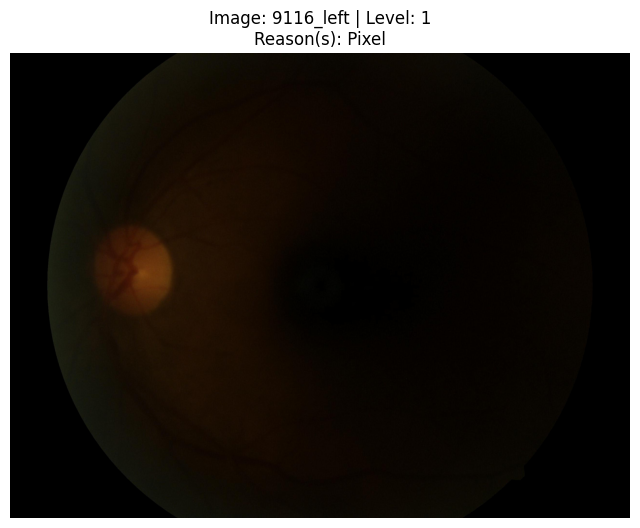

----------------------------------------


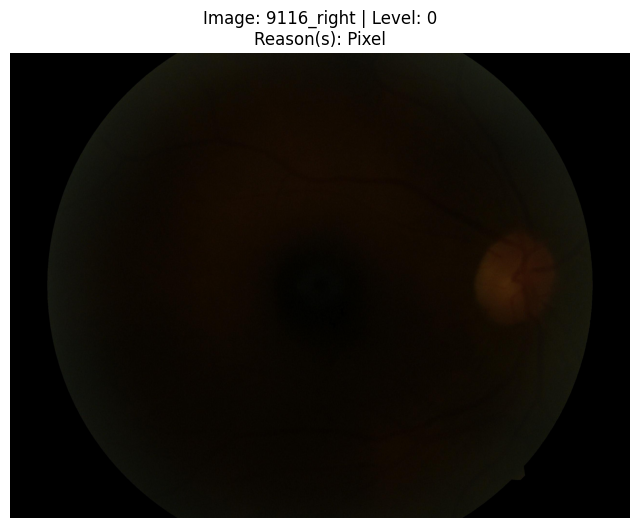

----------------------------------------


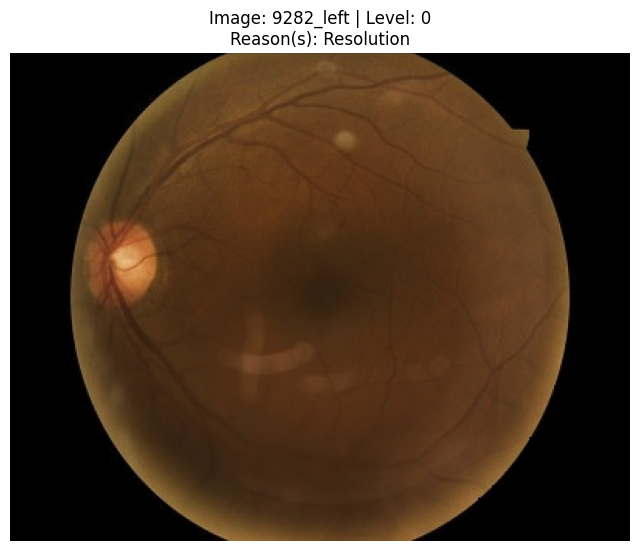

----------------------------------------


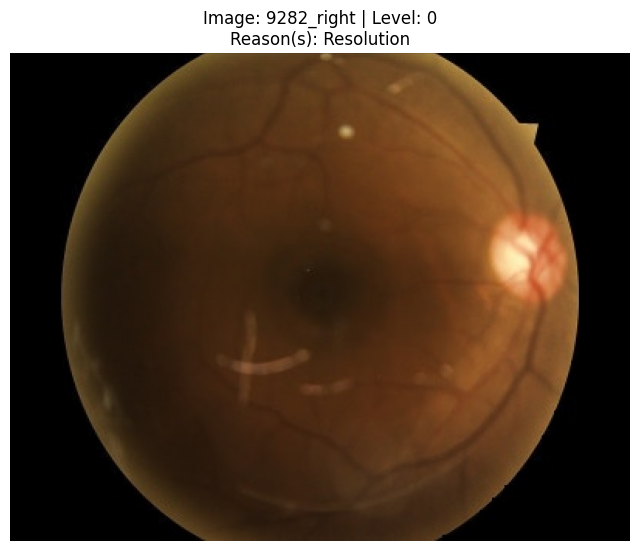

----------------------------------------


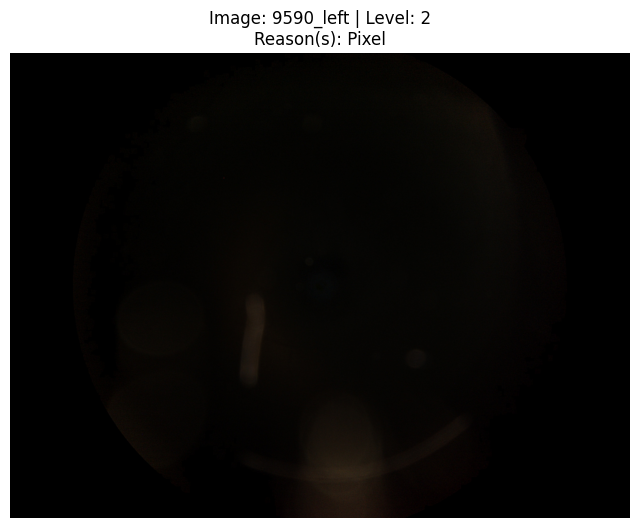

----------------------------------------


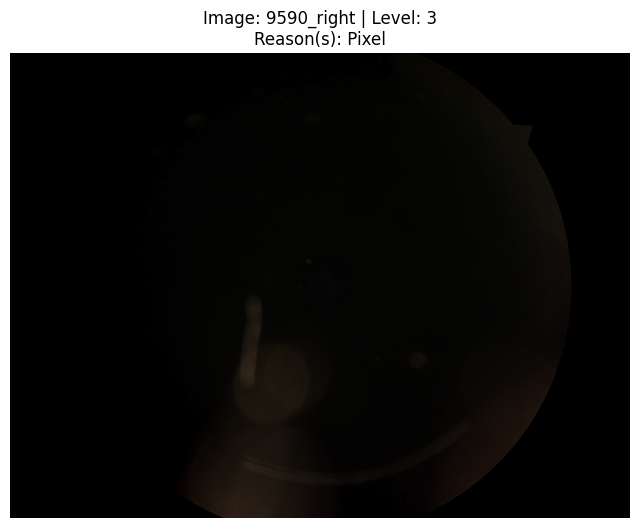

----------------------------------------


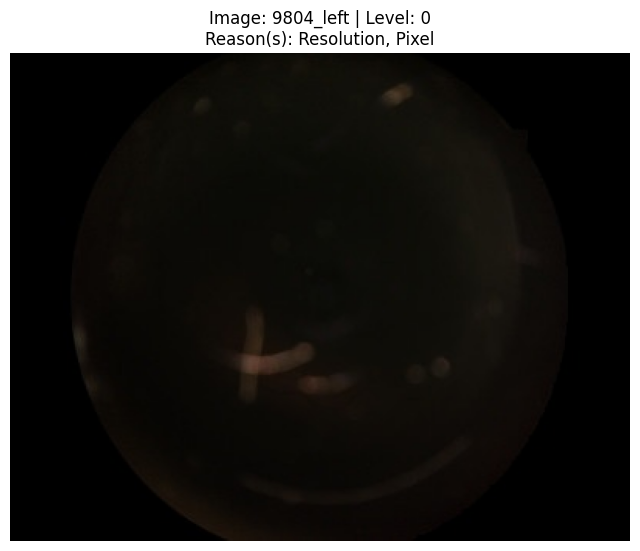

----------------------------------------


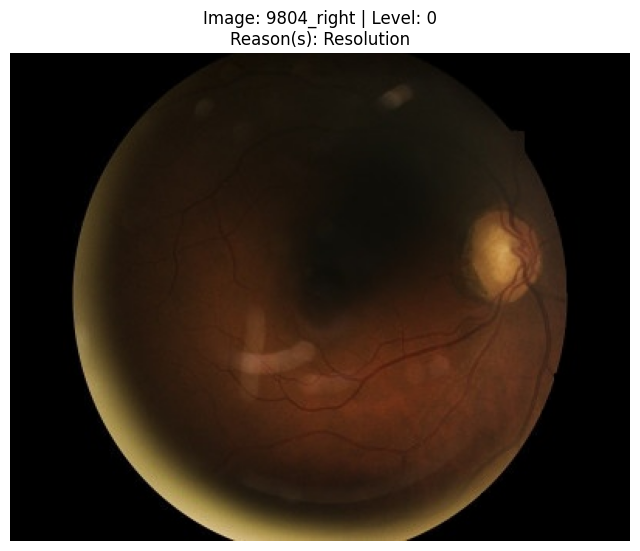

----------------------------------------


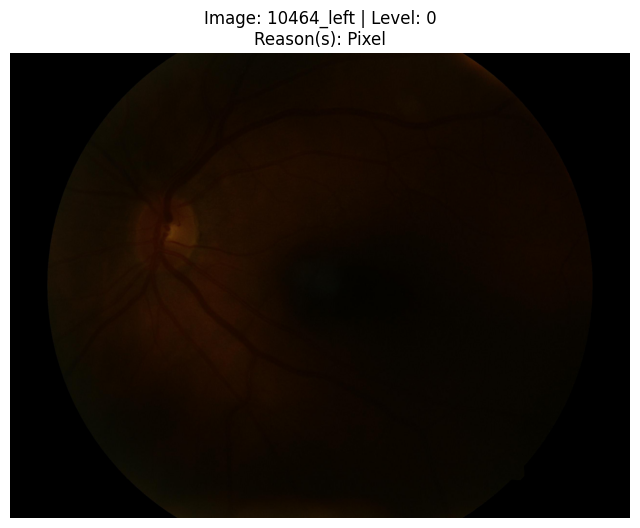

----------------------------------------


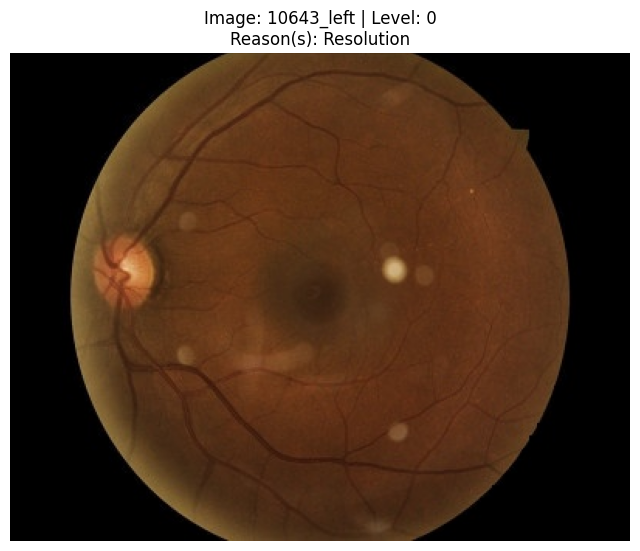

----------------------------------------


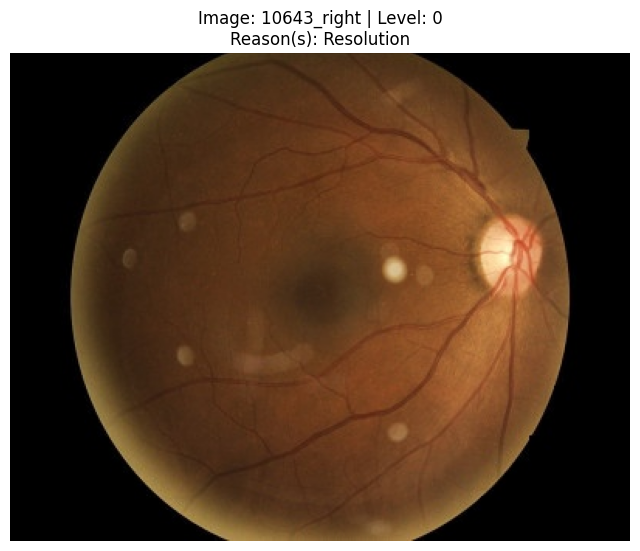

----------------------------------------


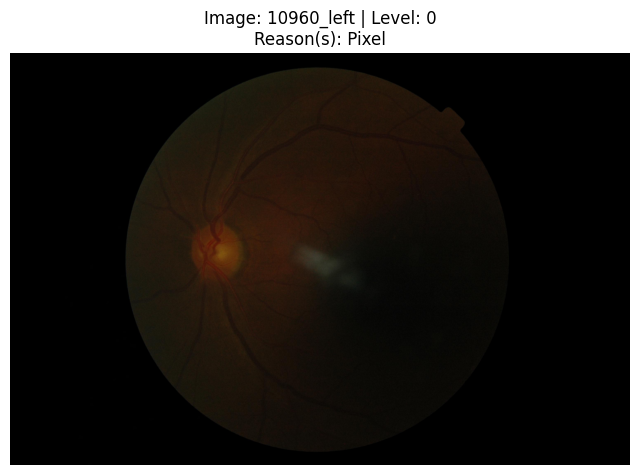

----------------------------------------


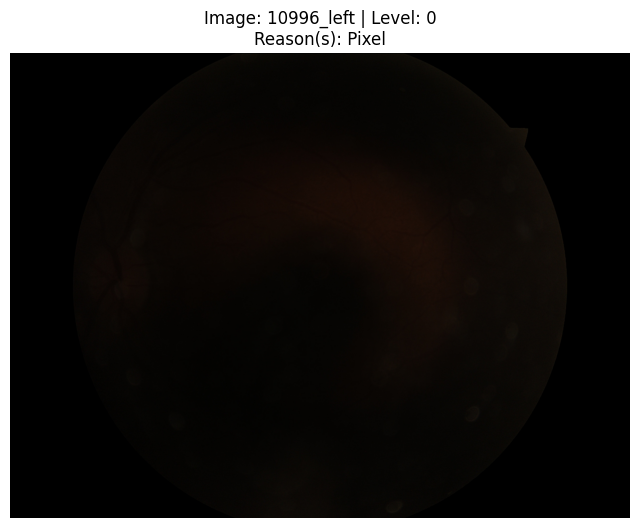

----------------------------------------


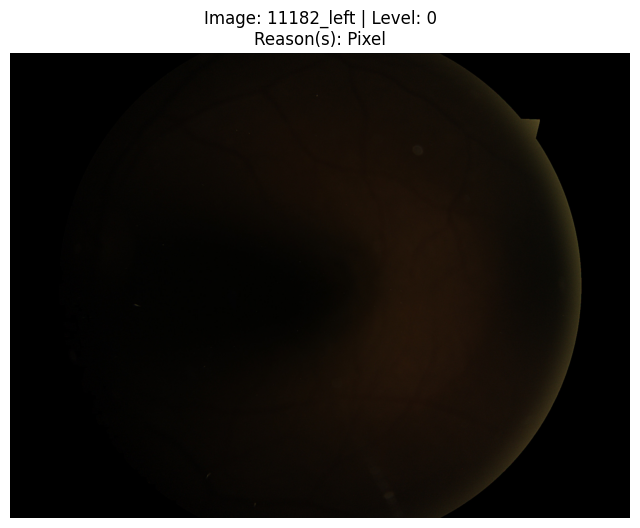

----------------------------------------


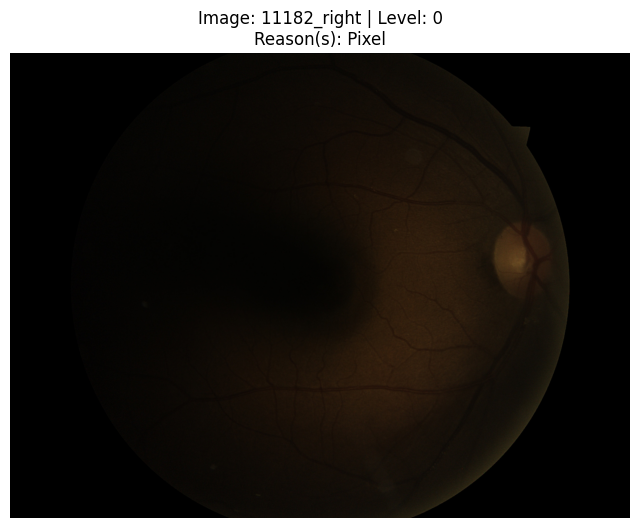

----------------------------------------


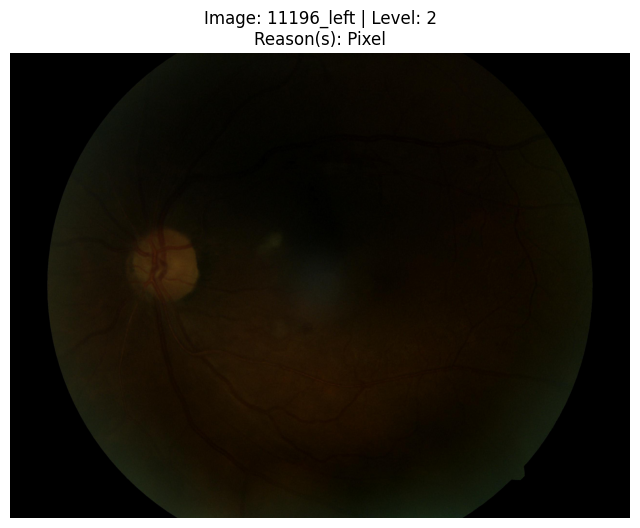

----------------------------------------


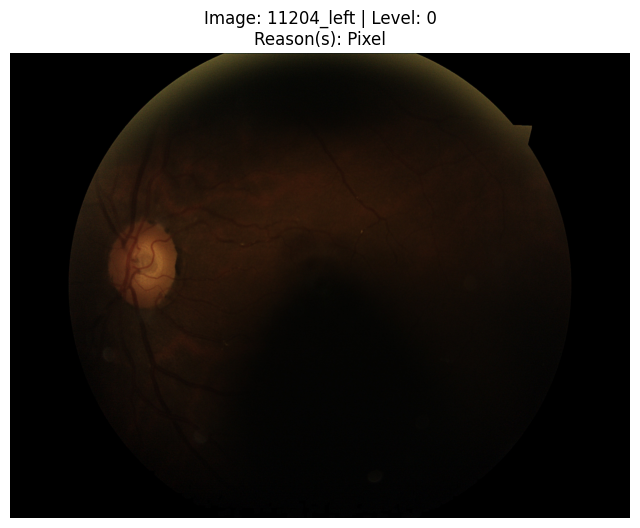

잘못된 입력입니다. k, d, u, q 중 하나를 입력하세요.
----------------------------------------


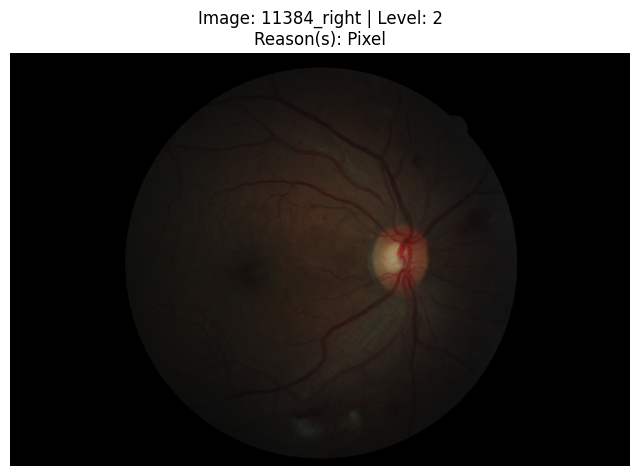

----------------------------------------


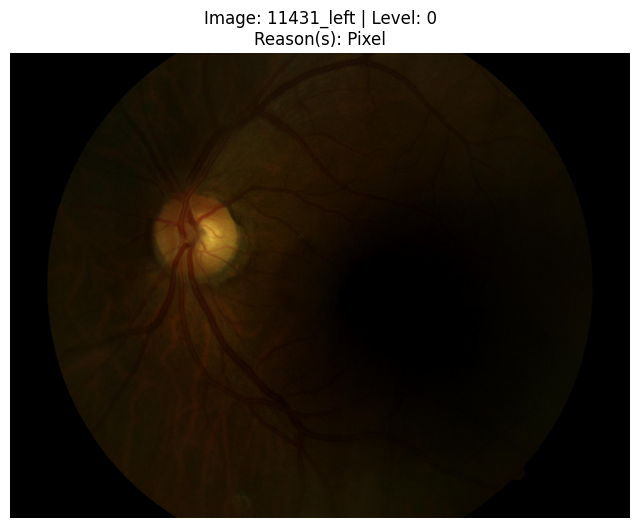

----------------------------------------


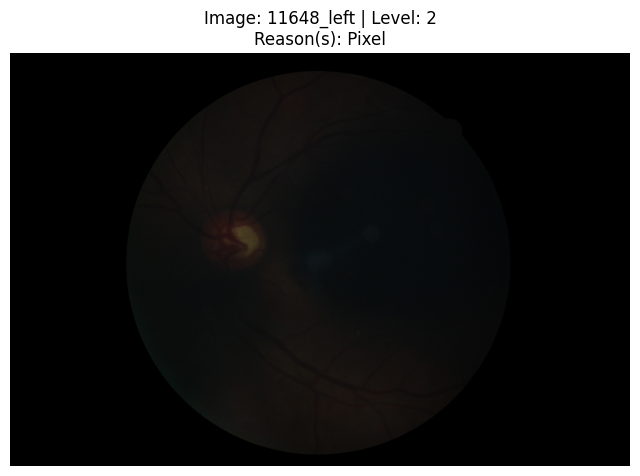

----------------------------------------


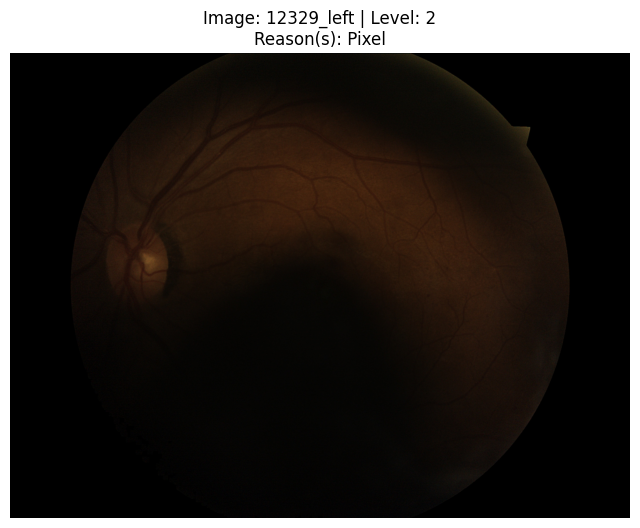

----------------------------------------


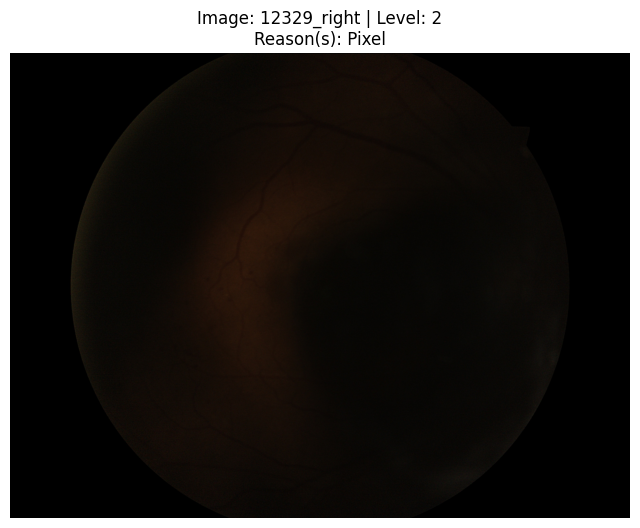

----------------------------------------


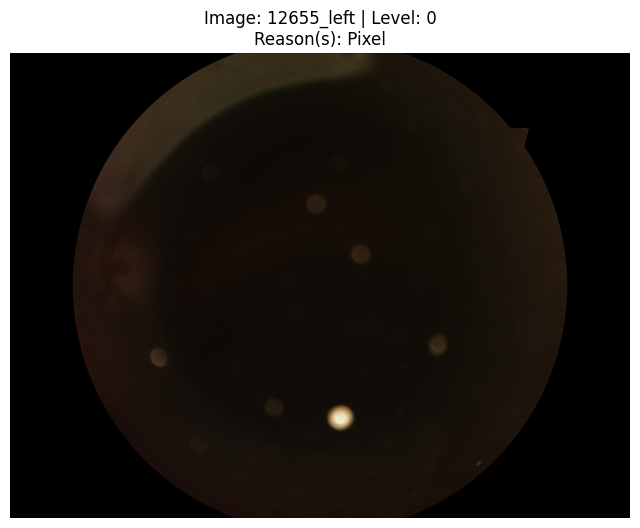

----------------------------------------


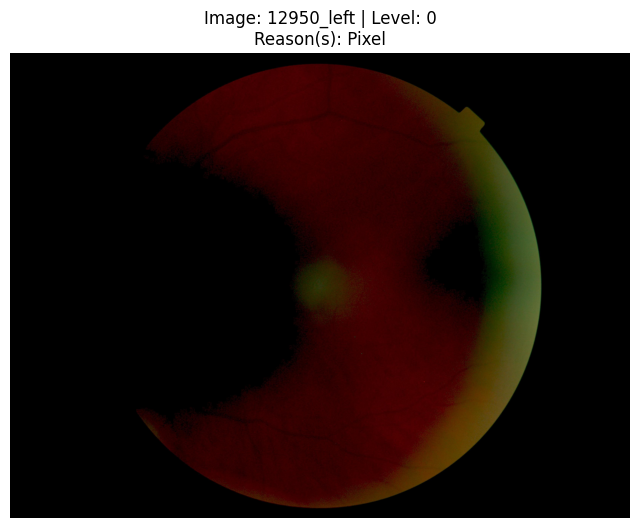

----------------------------------------


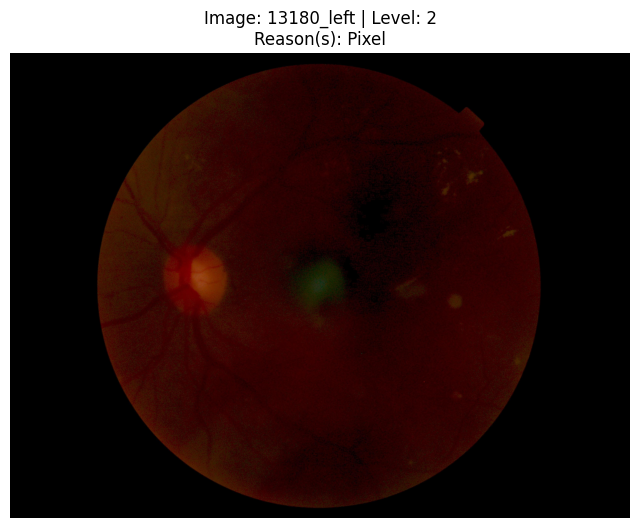

----------------------------------------


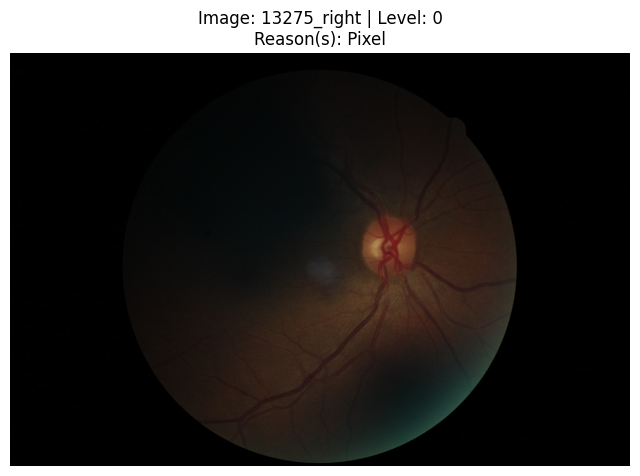

----------------------------------------


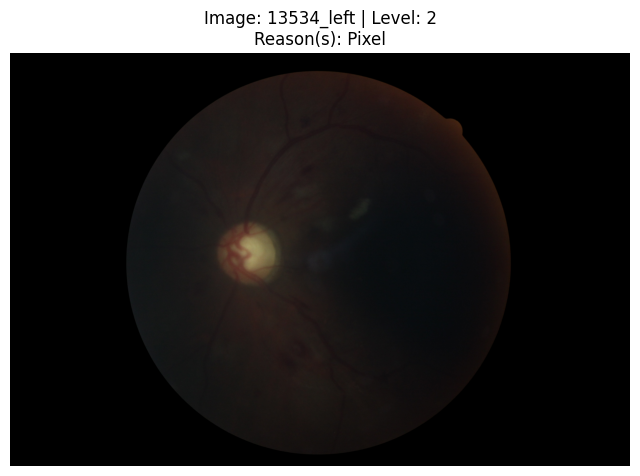

----------------------------------------


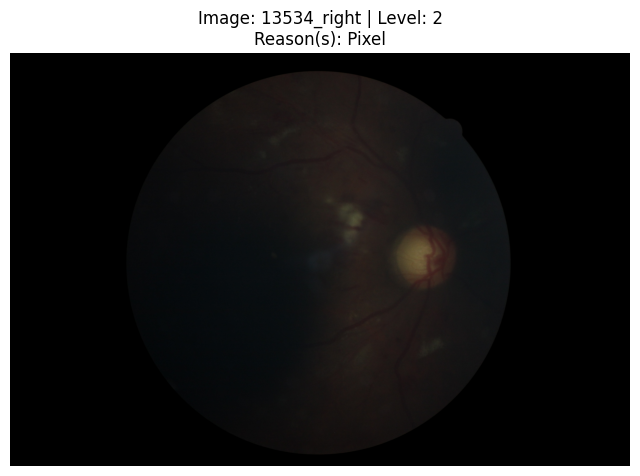

----------------------------------------


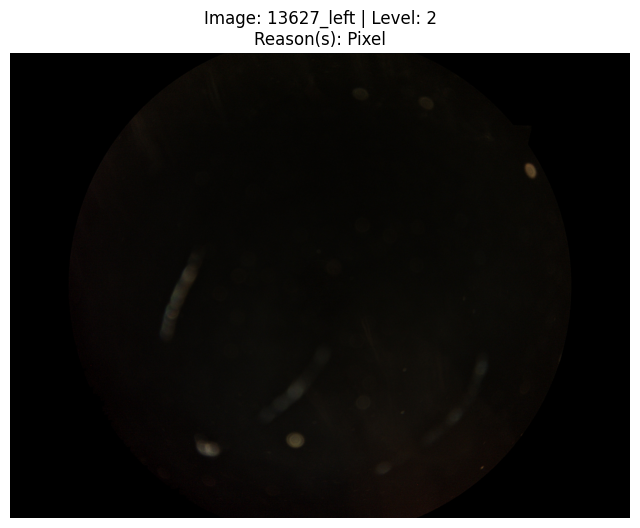

----------------------------------------


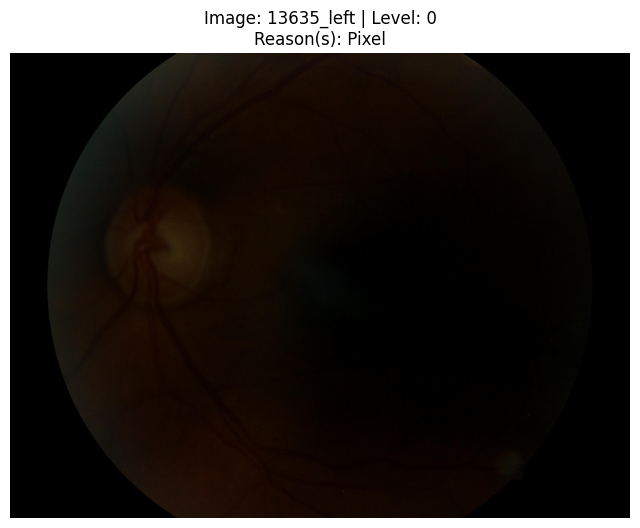

----------------------------------------


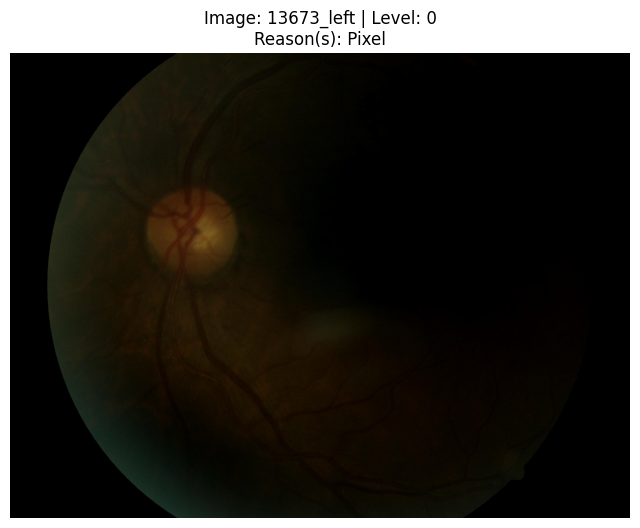

----------------------------------------


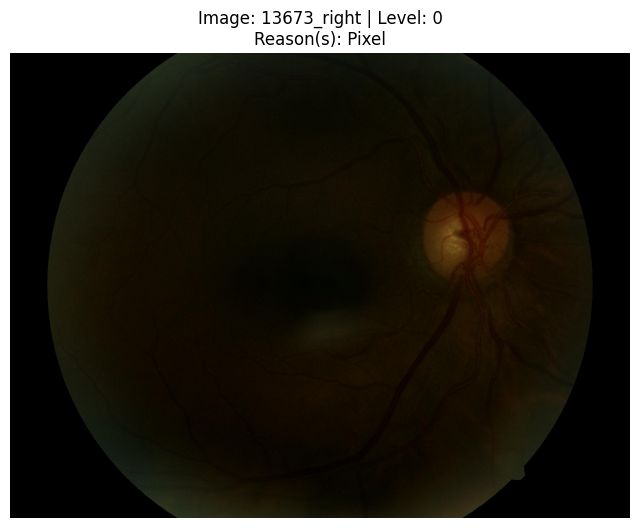

----------------------------------------


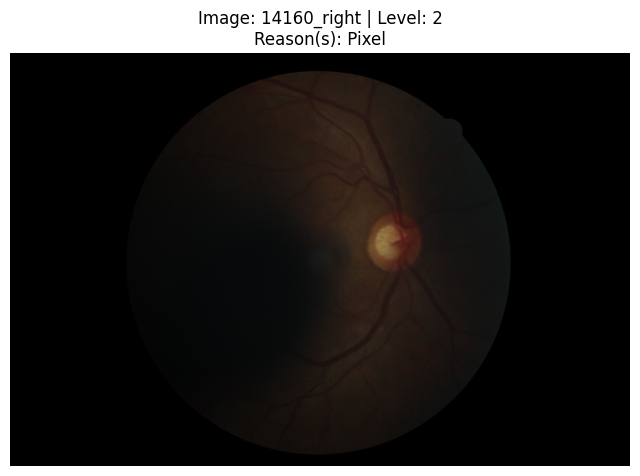

----------------------------------------


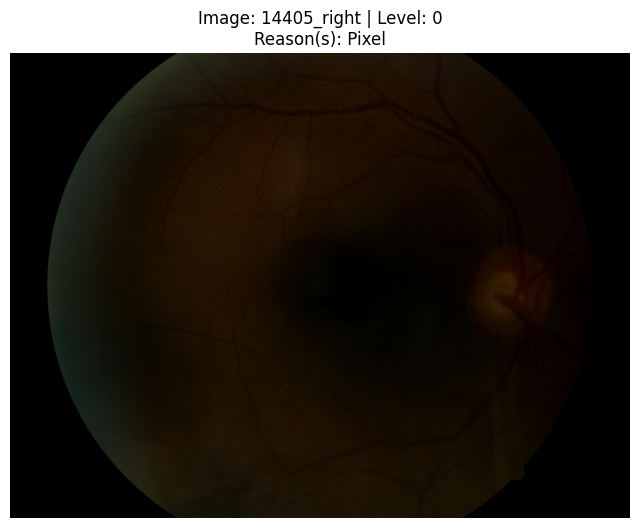

----------------------------------------


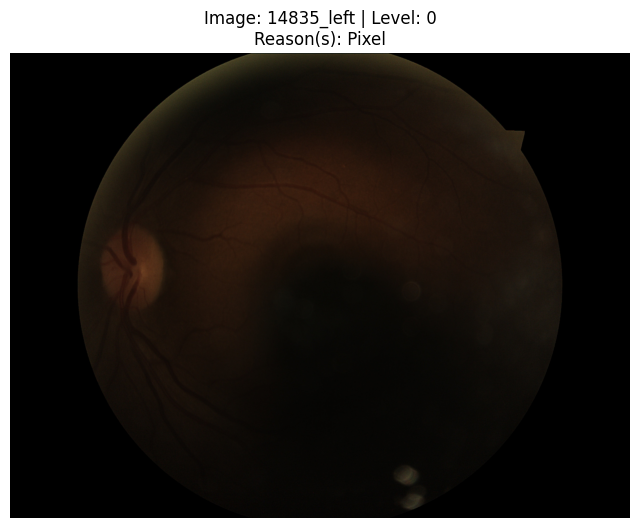

----------------------------------------


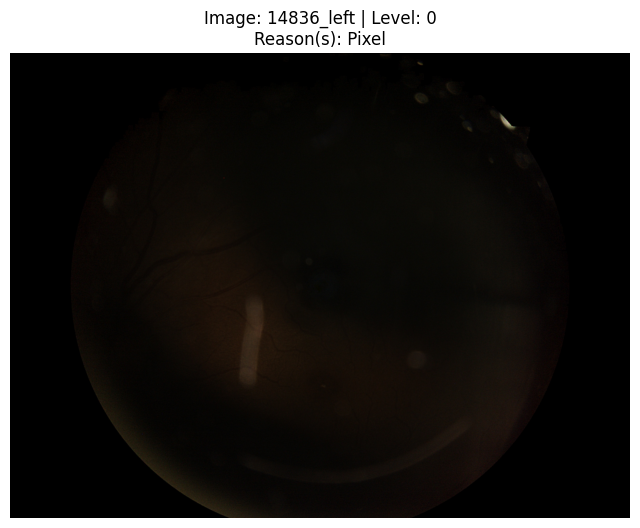

잘못된 입력입니다. k, d, u, q 중 하나를 입력하세요.
----------------------------------------


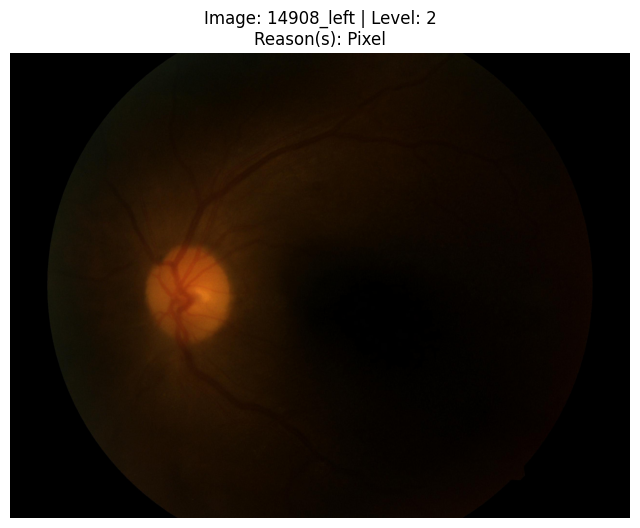

----------------------------------------


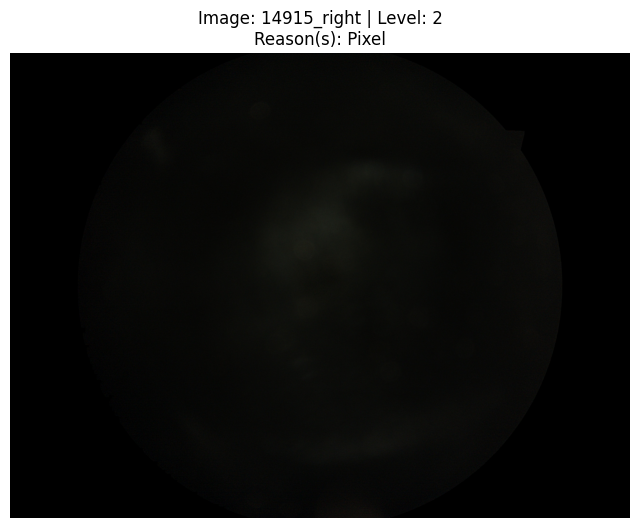

----------------------------------------


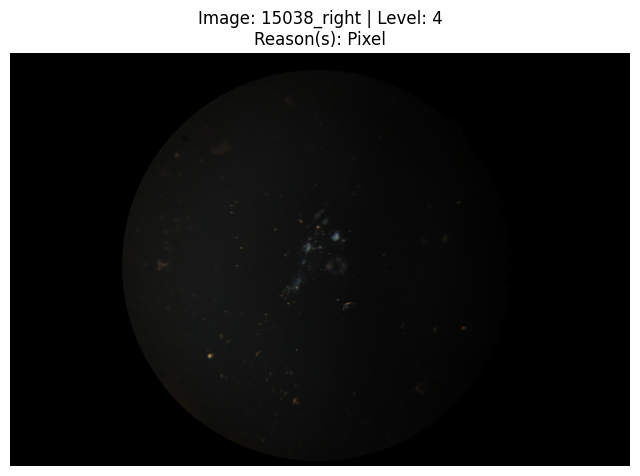

----------------------------------------


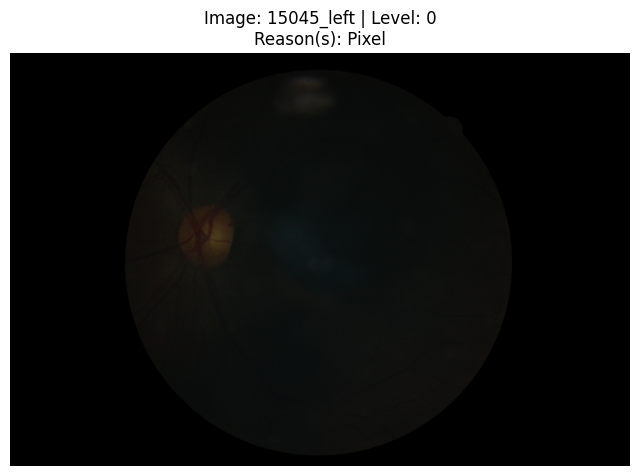

----------------------------------------


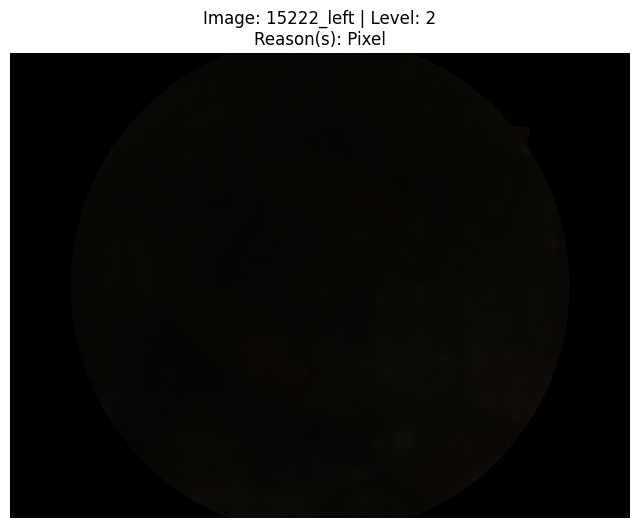

----------------------------------------


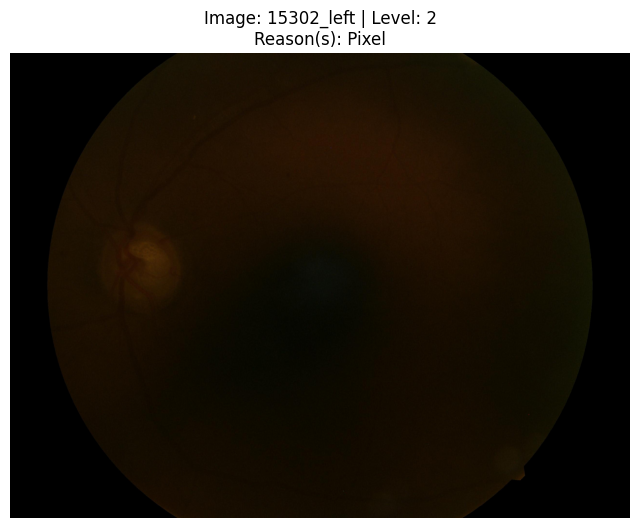

----------------------------------------


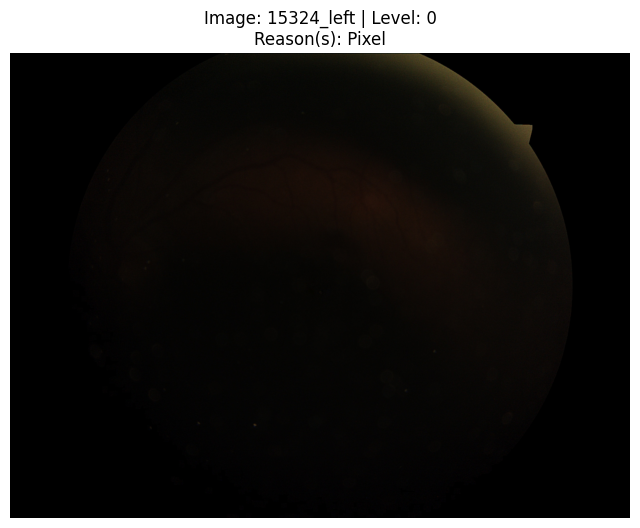

잘못된 입력입니다. k, d, u, q 중 하나를 입력하세요.
----------------------------------------


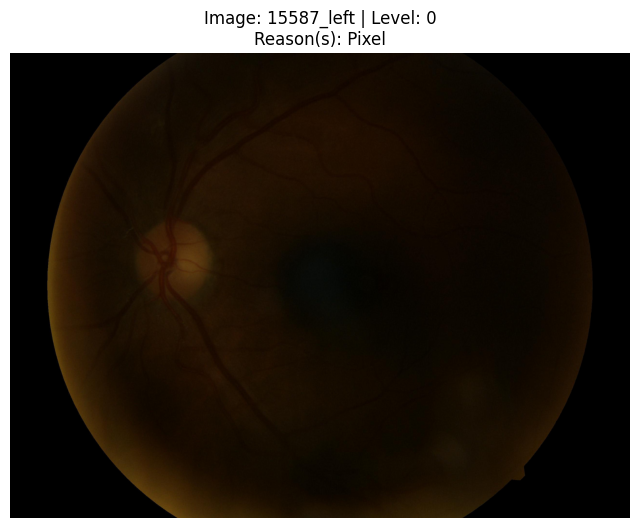

----------------------------------------


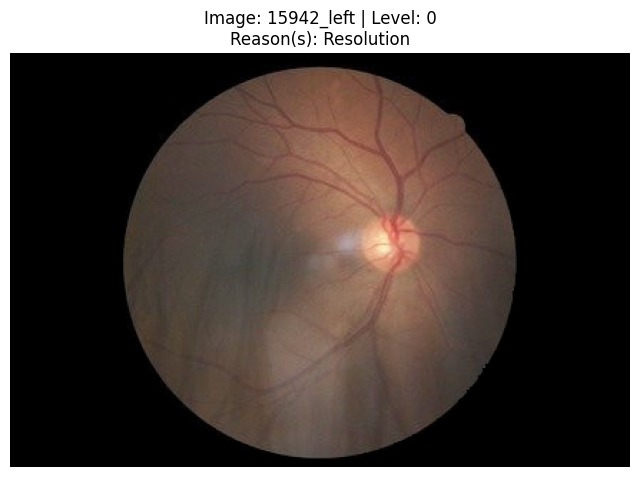

----------------------------------------


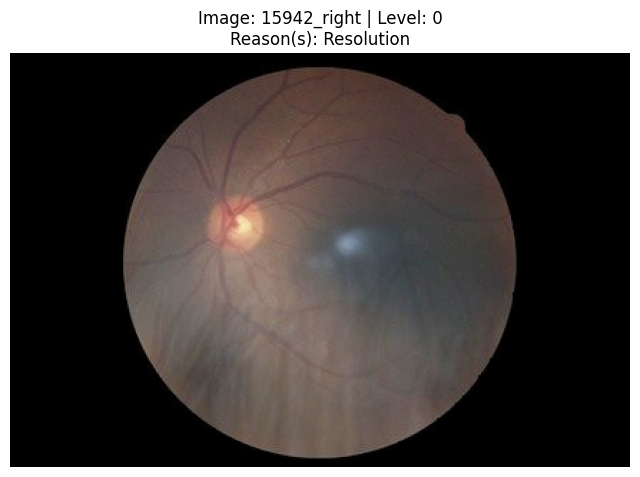

----------------------------------------


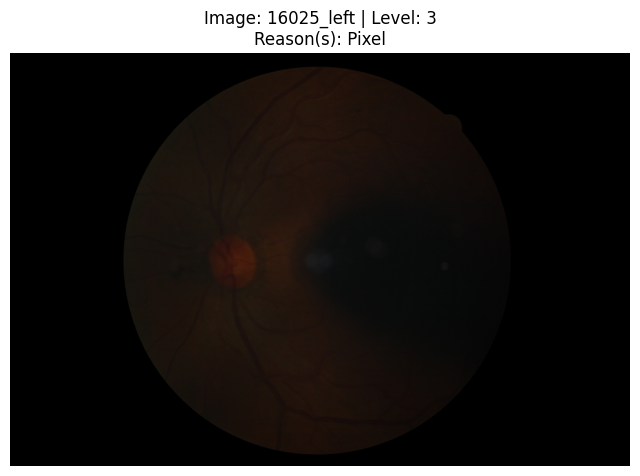

----------------------------------------


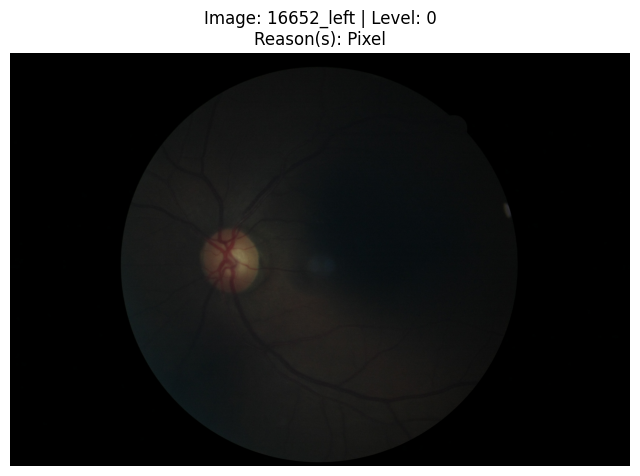

----------------------------------------


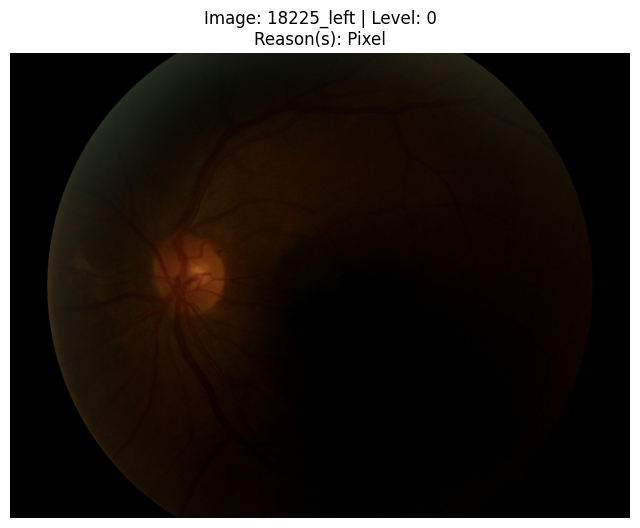

----------------------------------------


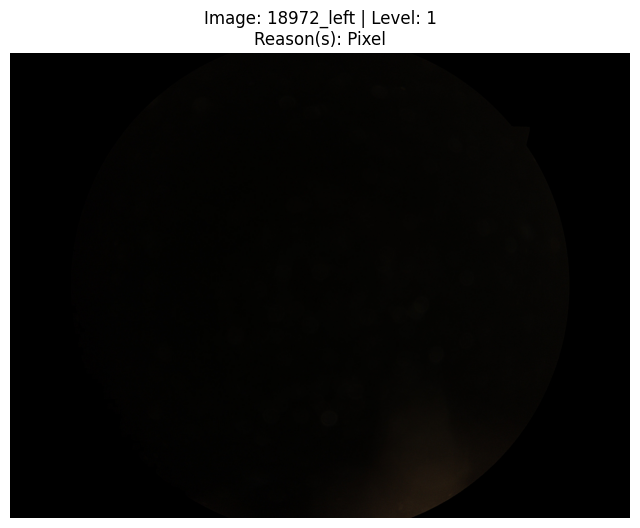

----------------------------------------


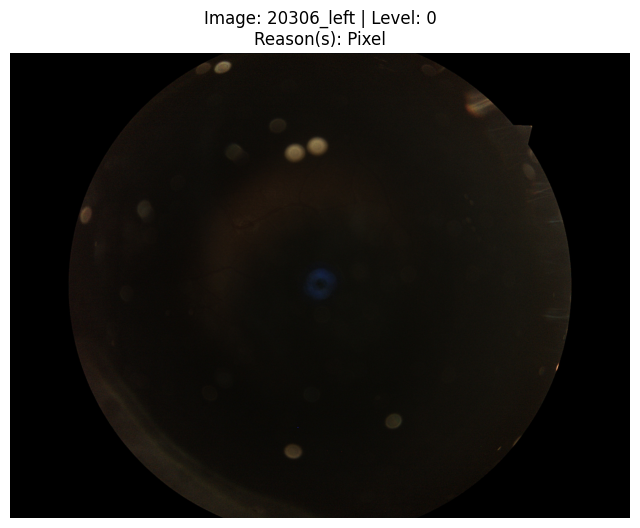

----------------------------------------


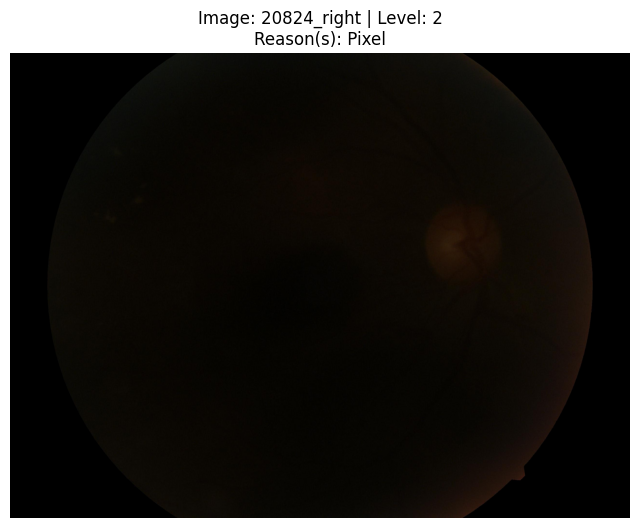

----------------------------------------


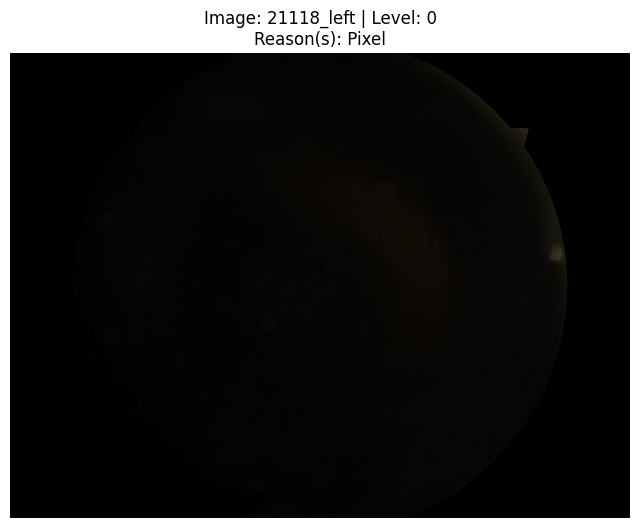

----------------------------------------


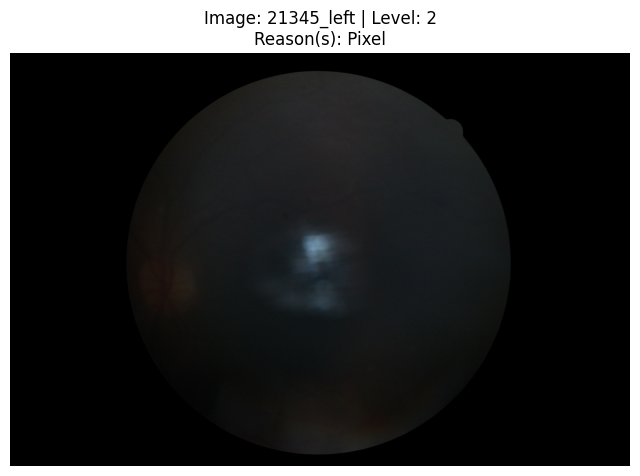

----------------------------------------


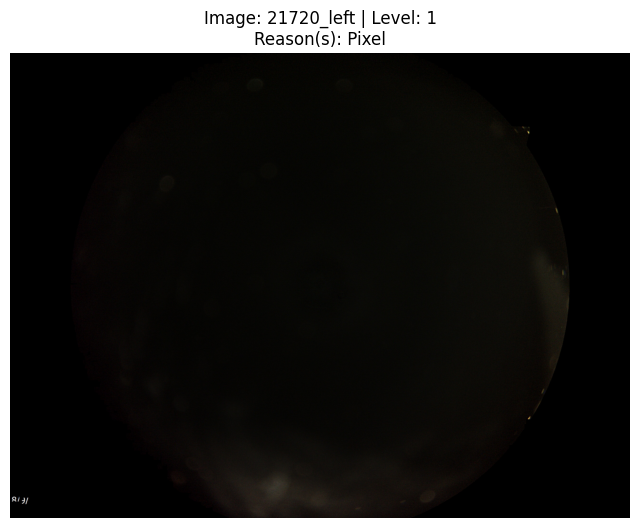

----------------------------------------


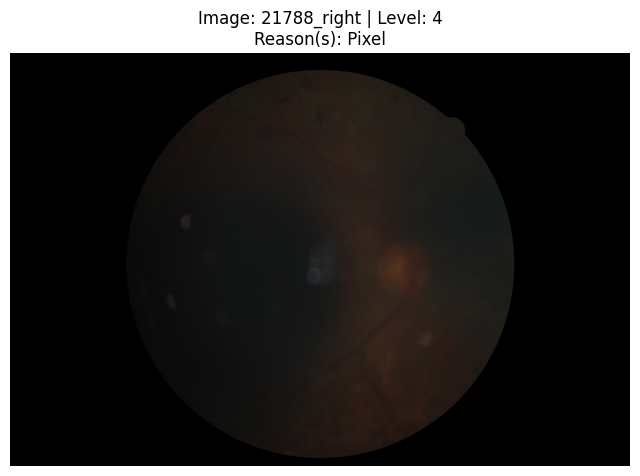

----------------------------------------


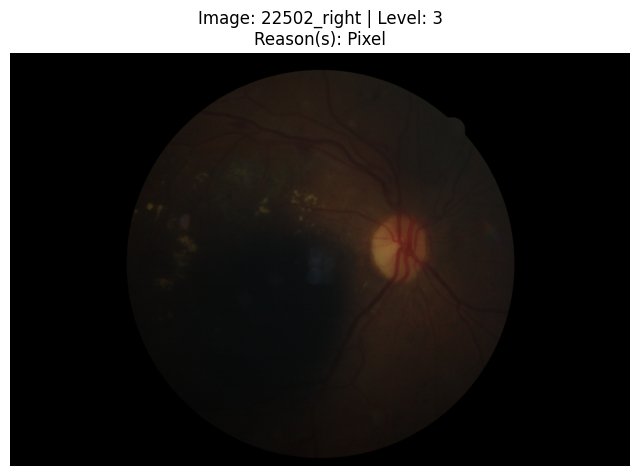

----------------------------------------


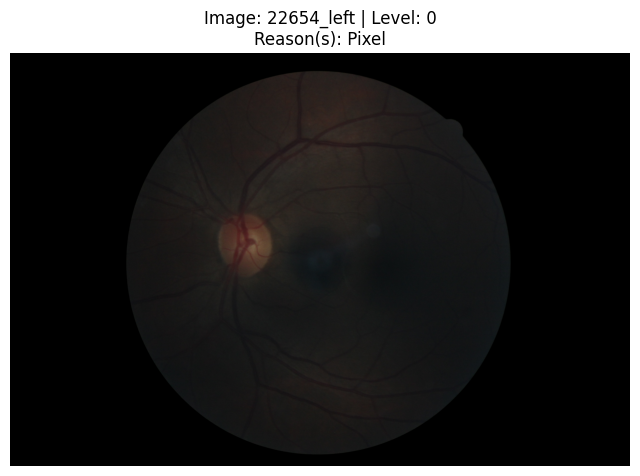

----------------------------------------


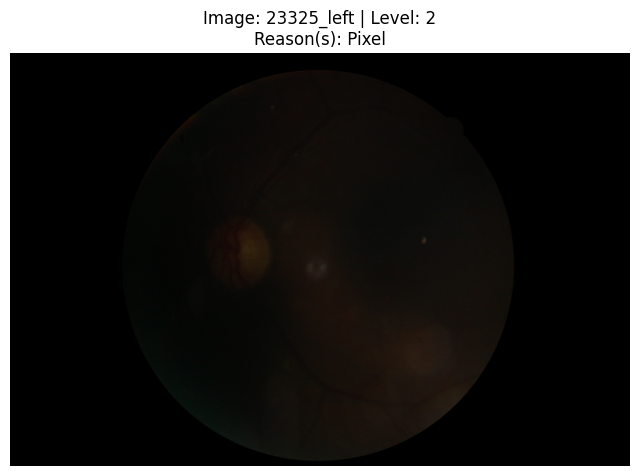

----------------------------------------


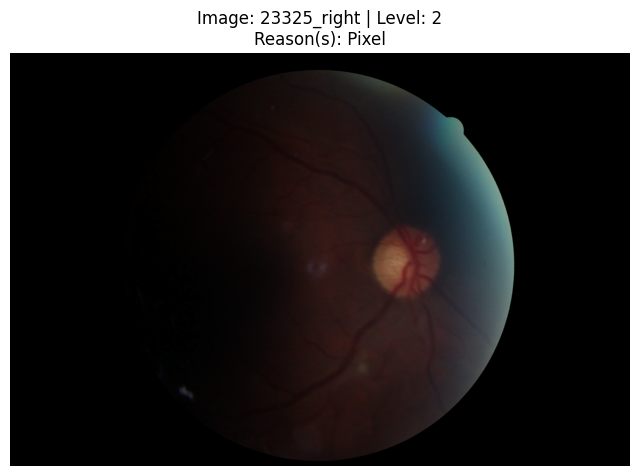

----------------------------------------


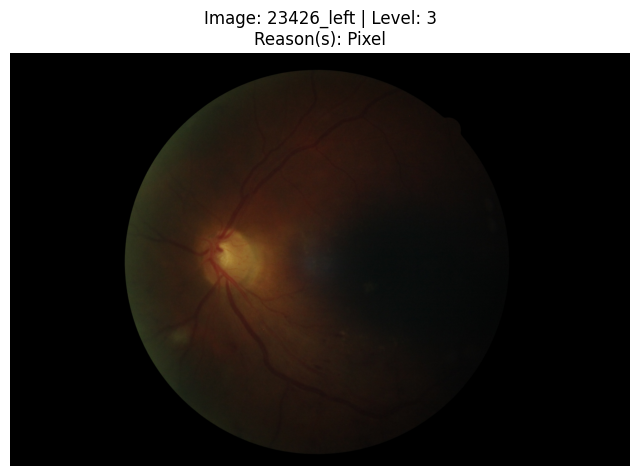

----------------------------------------


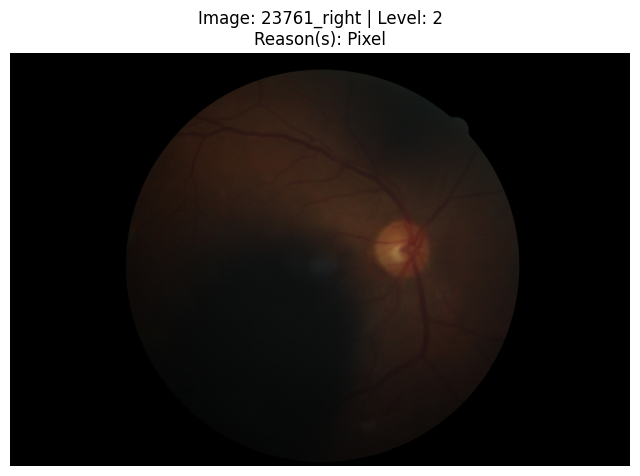

----------------------------------------


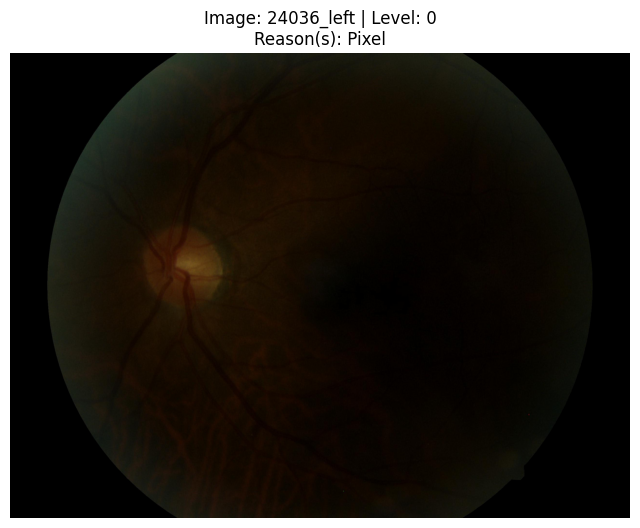

----------------------------------------


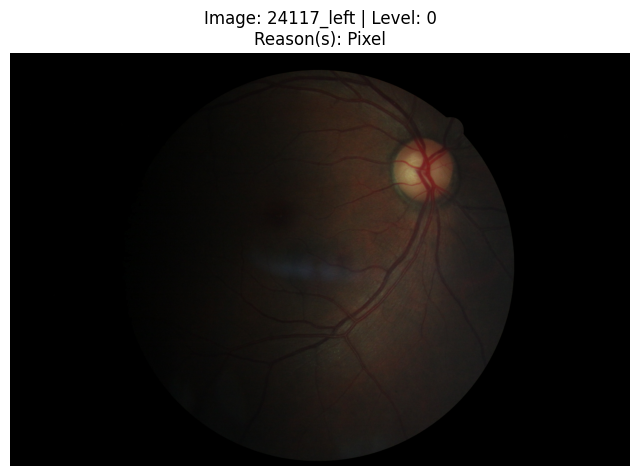

----------------------------------------


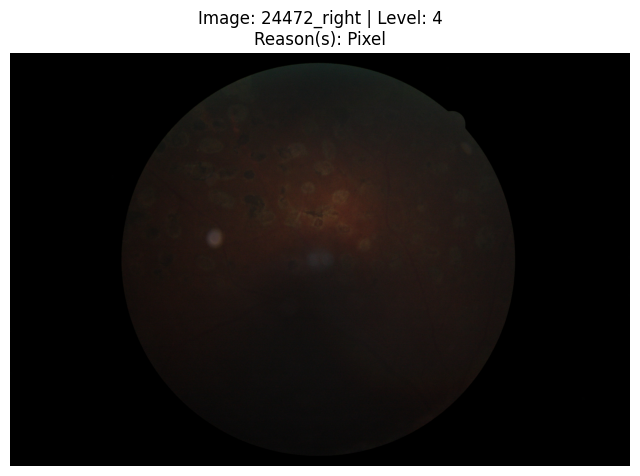

----------------------------------------


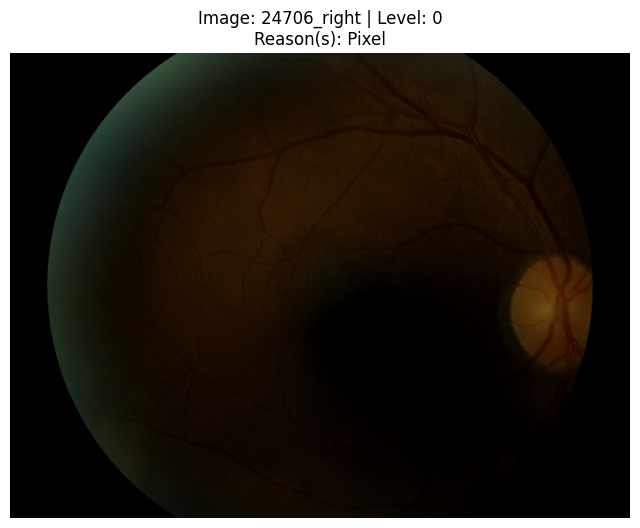

----------------------------------------


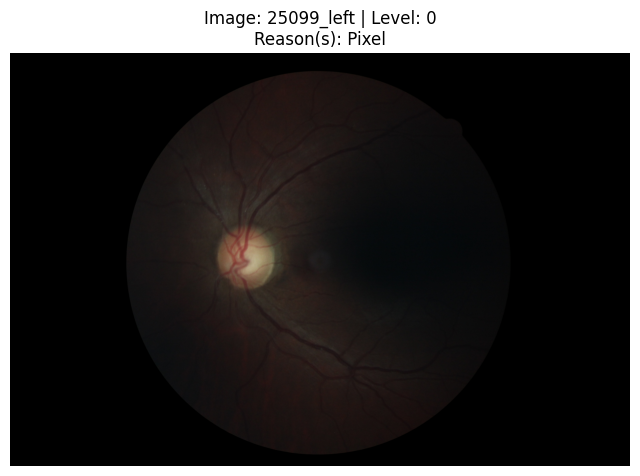

----------------------------------------


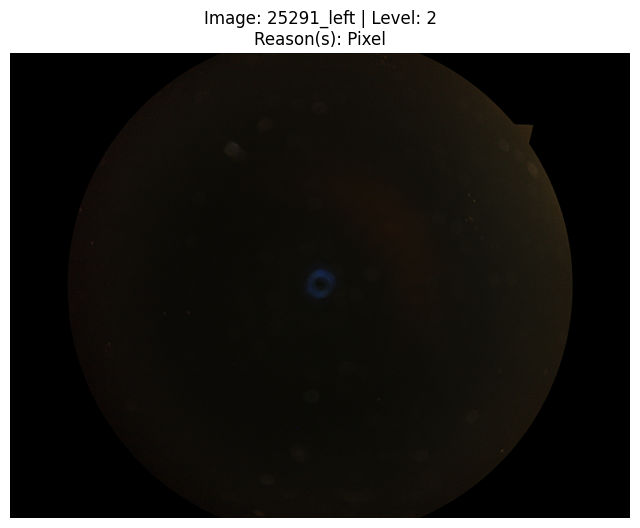

----------------------------------------


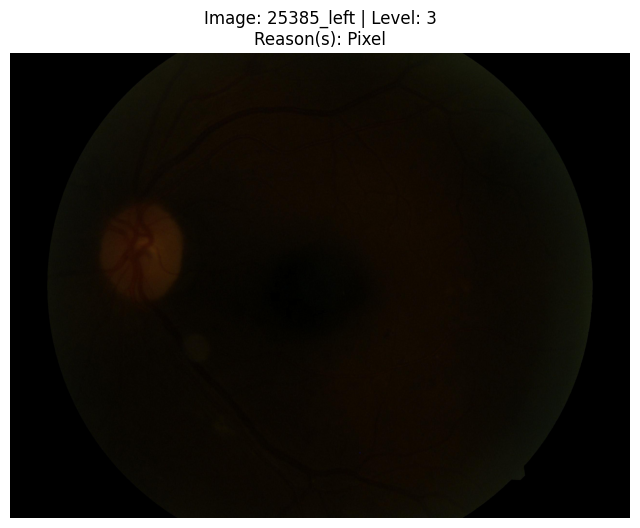

----------------------------------------


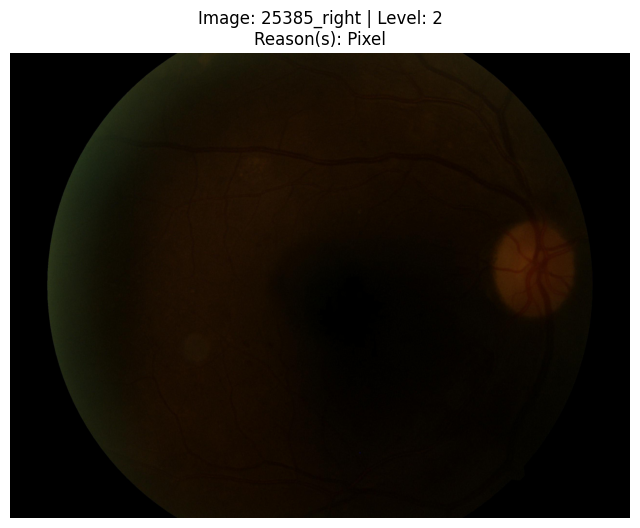

----------------------------------------


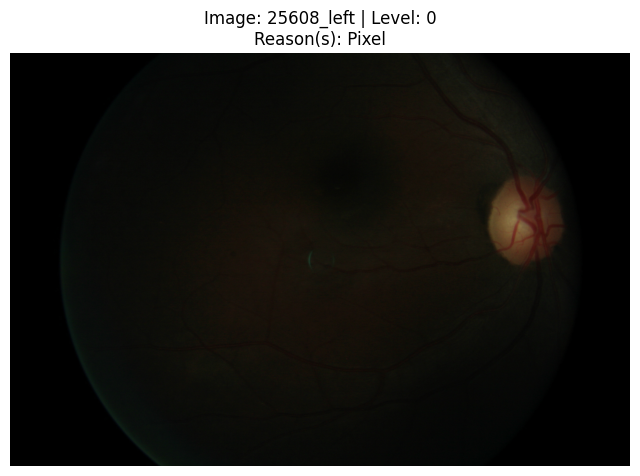

----------------------------------------


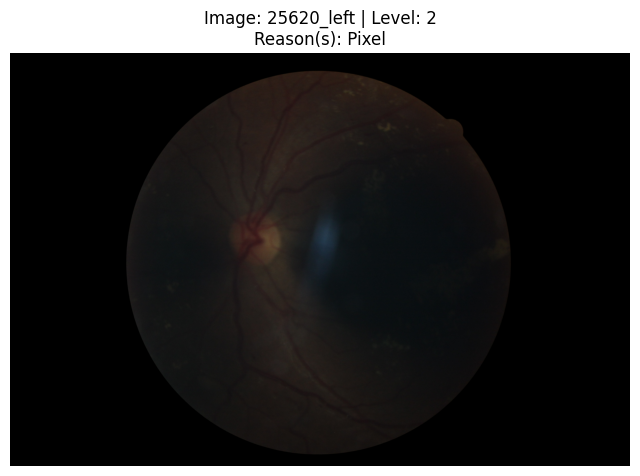

----------------------------------------


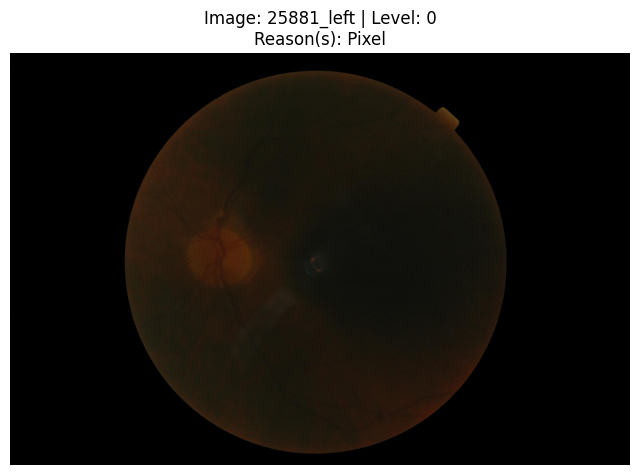

----------------------------------------


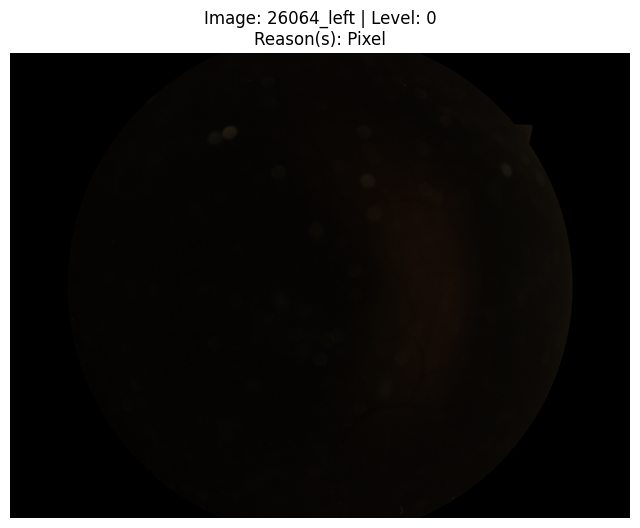

----------------------------------------


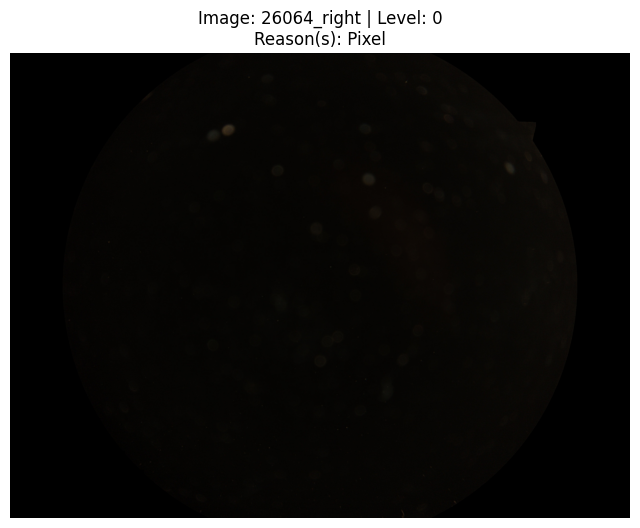

----------------------------------------


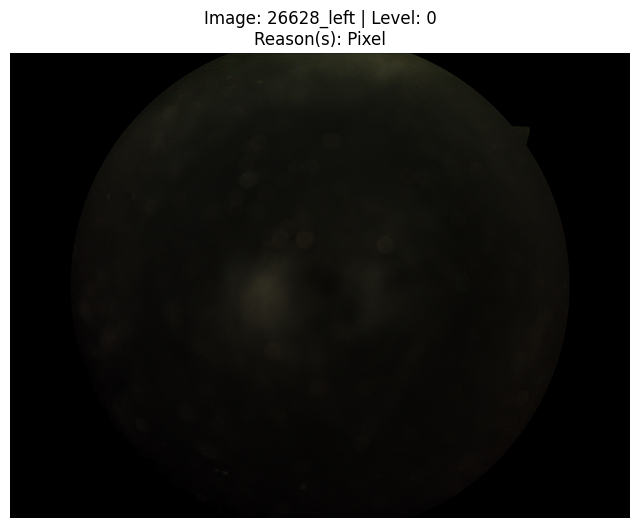

----------------------------------------


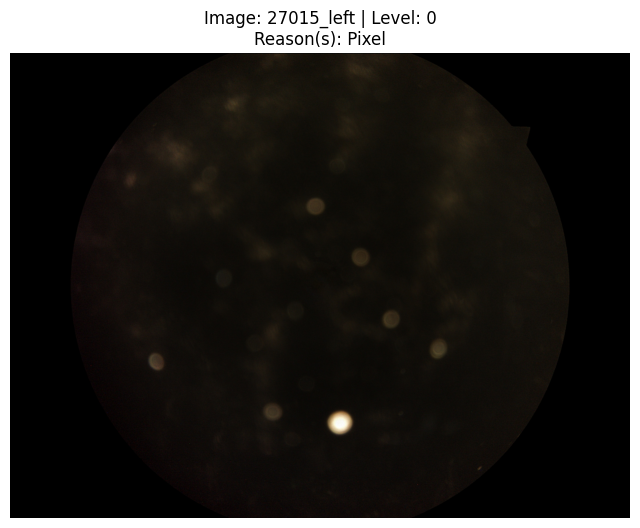

----------------------------------------


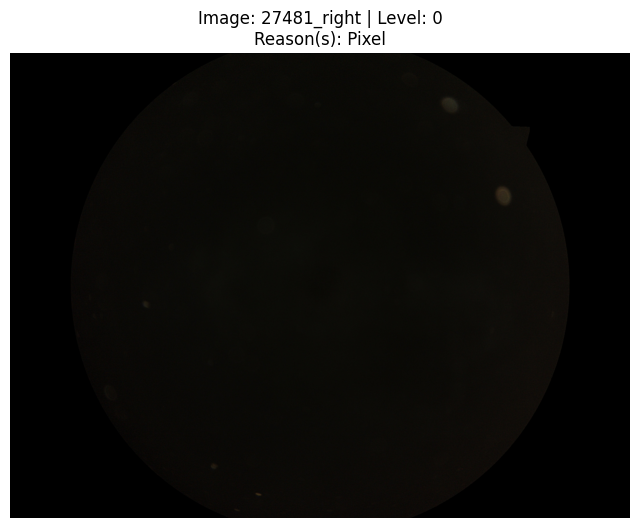

----------------------------------------


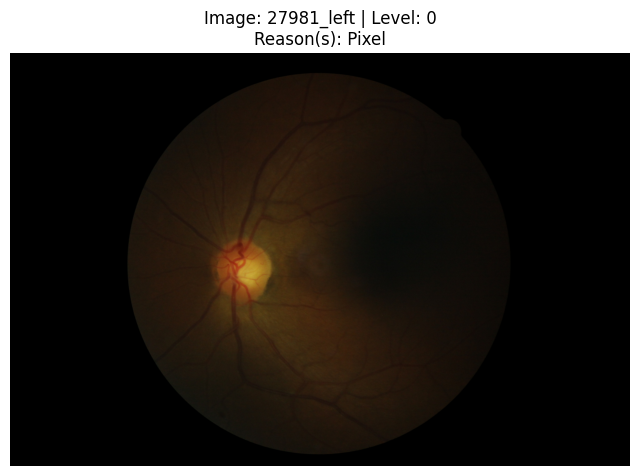

----------------------------------------


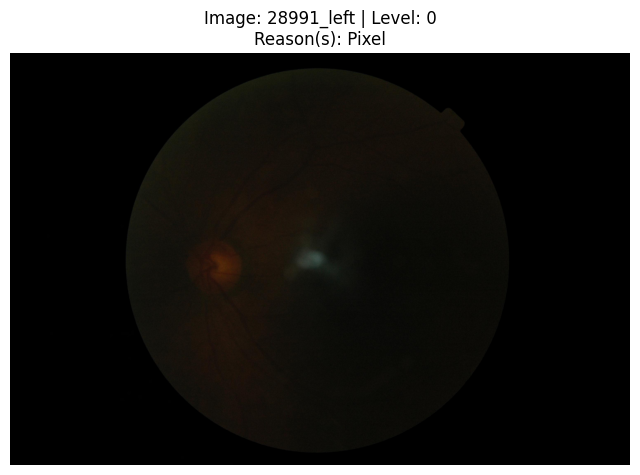

----------------------------------------


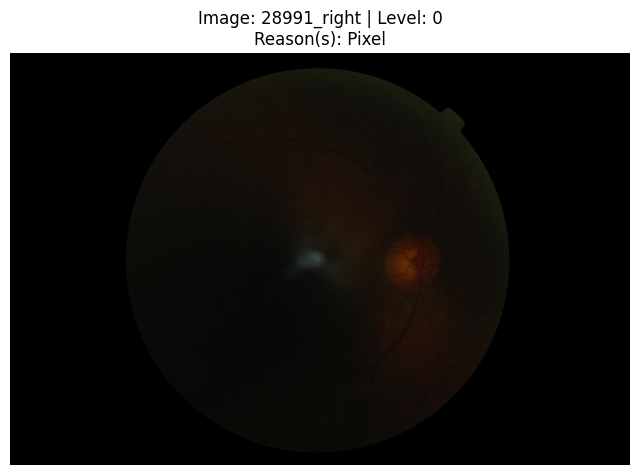

----------------------------------------


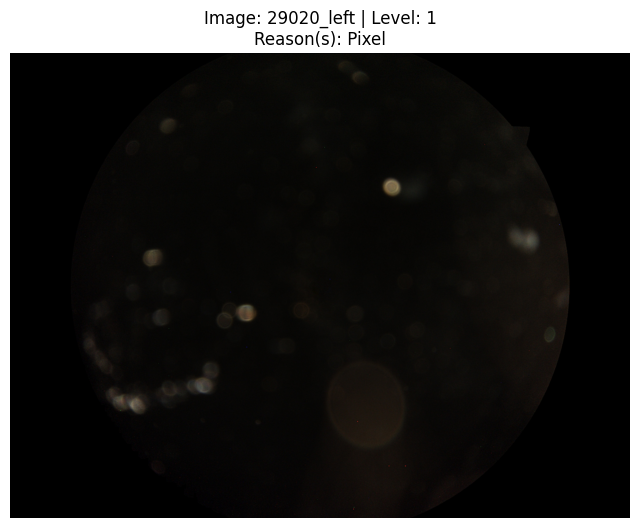

----------------------------------------


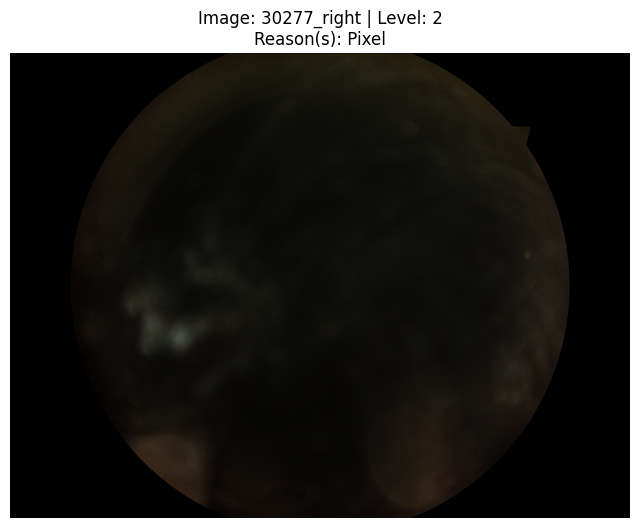

----------------------------------------


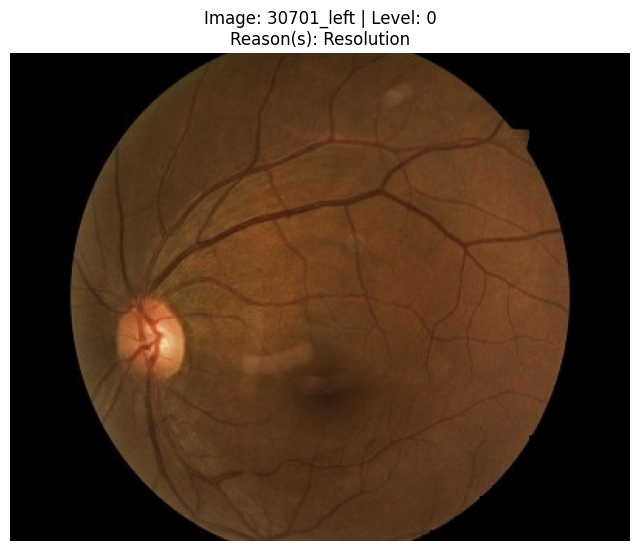

----------------------------------------


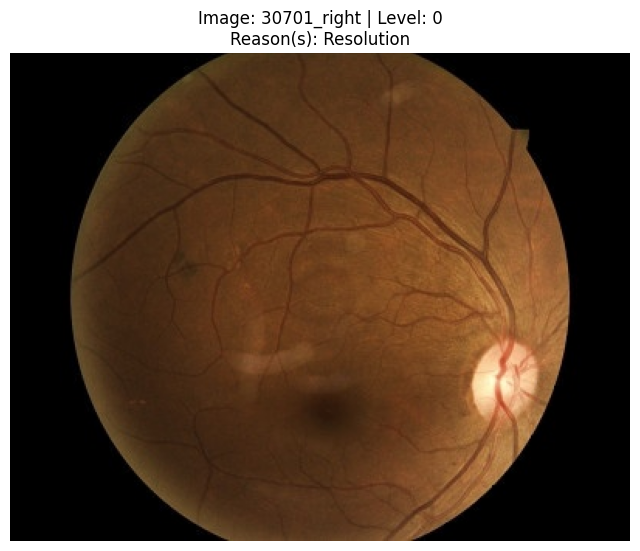

잘못된 입력입니다. k, d, u, q 중 하나를 입력하세요.
----------------------------------------


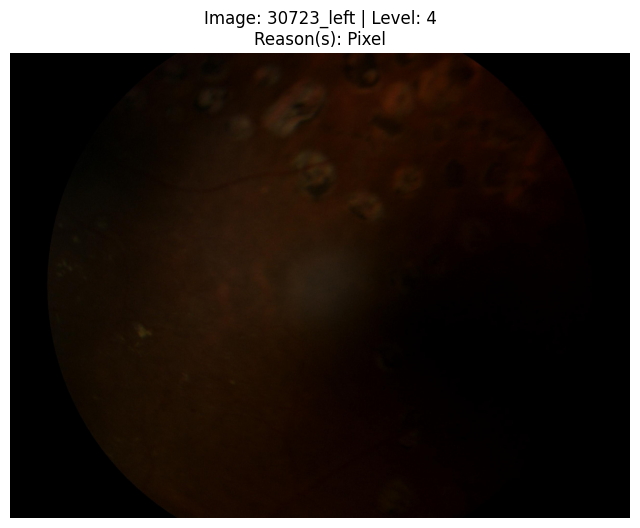

----------------------------------------


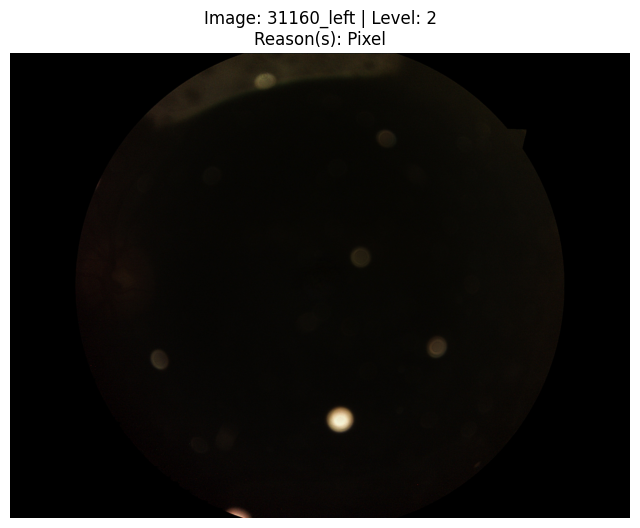

잘못된 입력입니다. k, d, u, q 중 하나를 입력하세요.
----------------------------------------


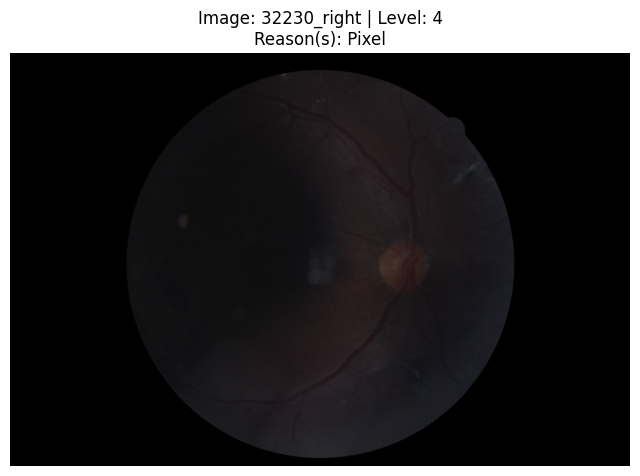

----------------------------------------


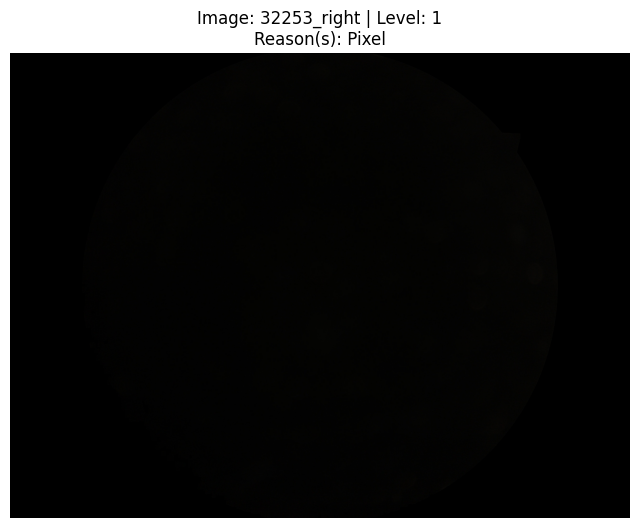

----------------------------------------


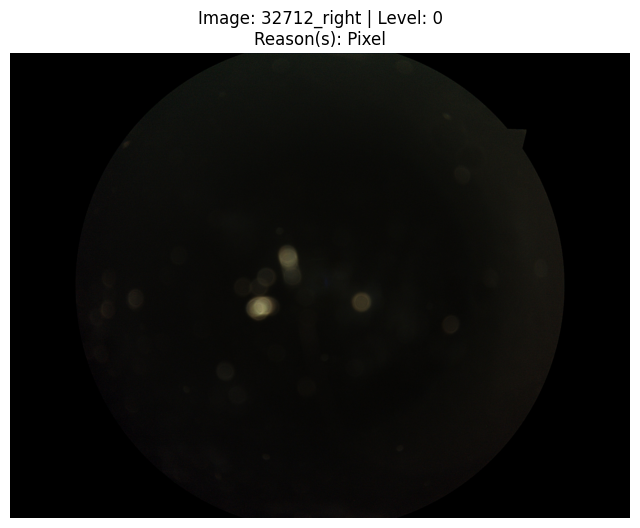

----------------------------------------


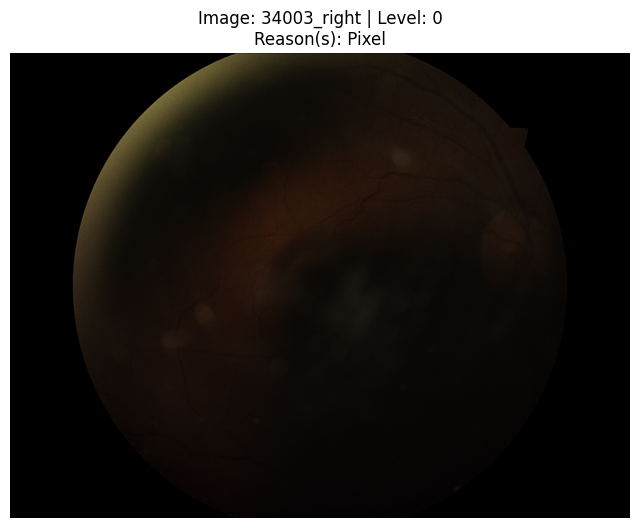

----------------------------------------


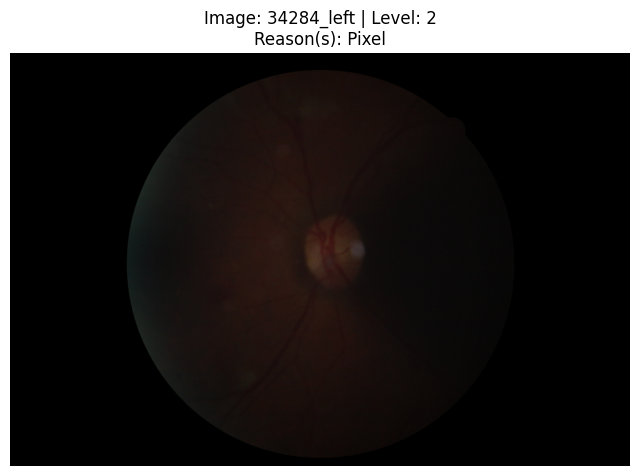

----------------------------------------


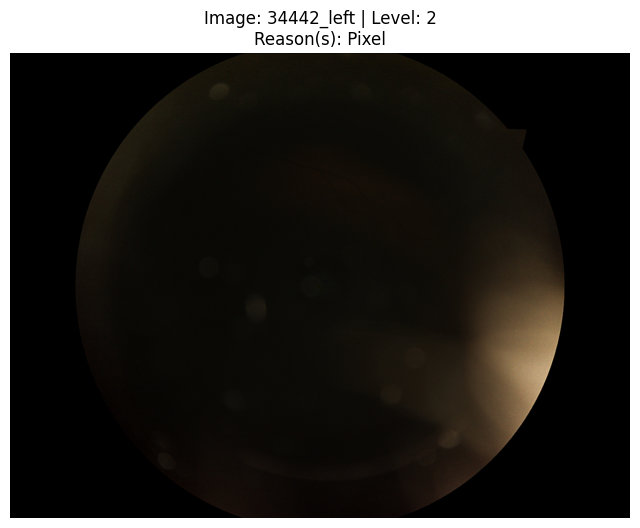

----------------------------------------


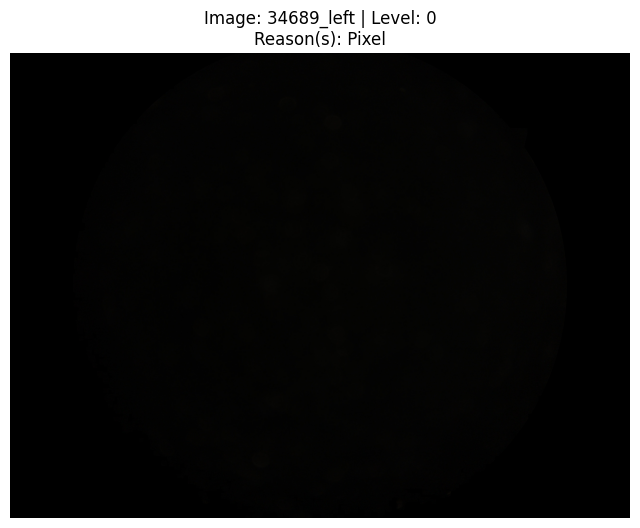

----------------------------------------


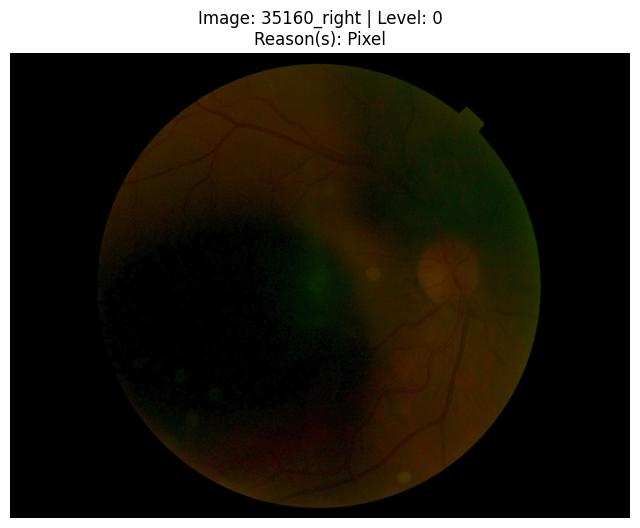

----------------------------------------


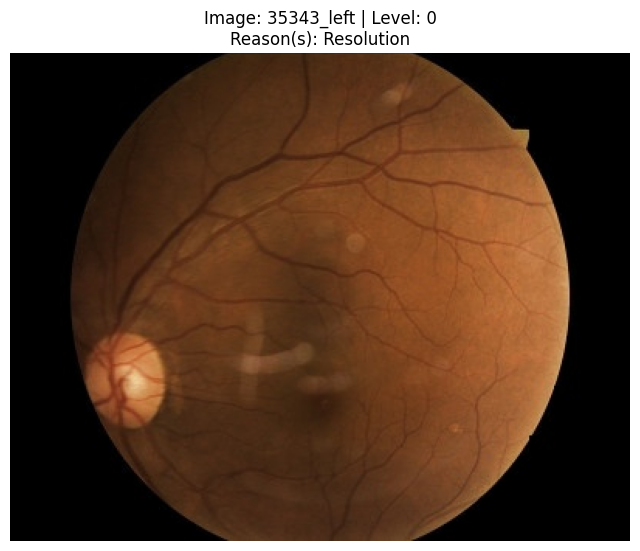

----------------------------------------


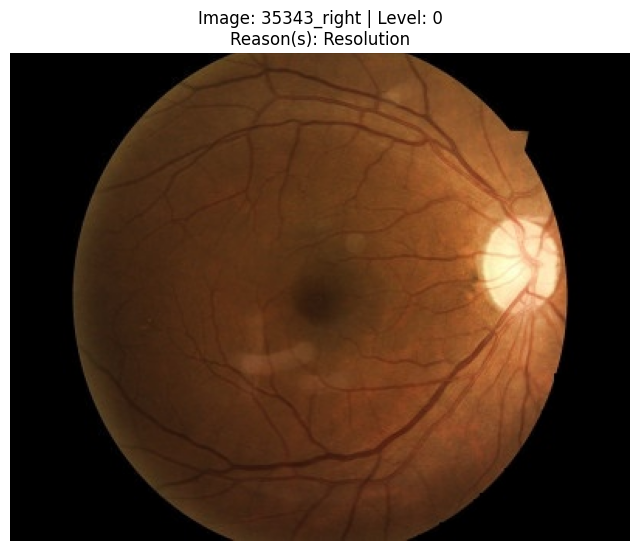

----------------------------------------


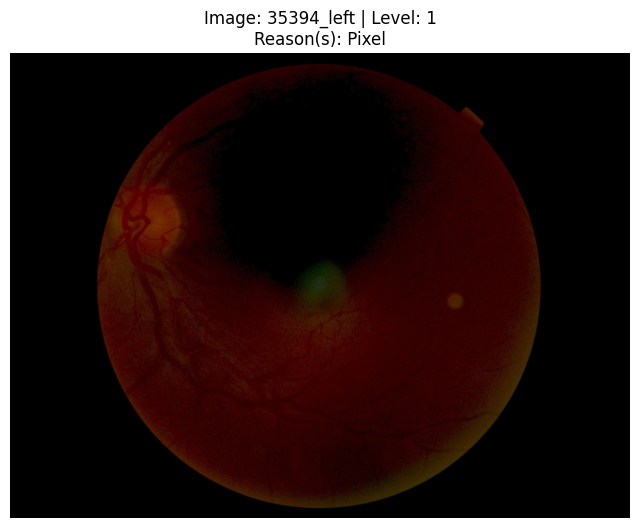

----------------------------------------


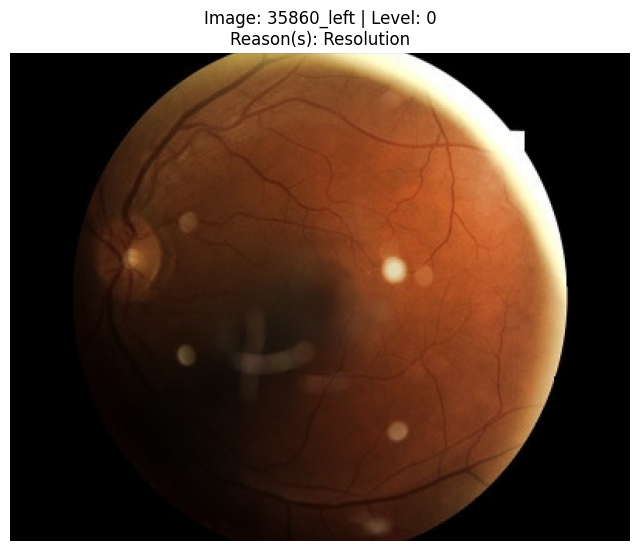

----------------------------------------


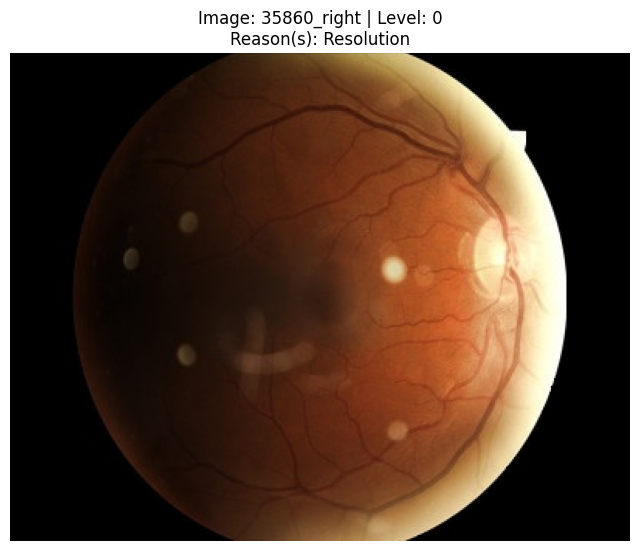

----------------------------------------


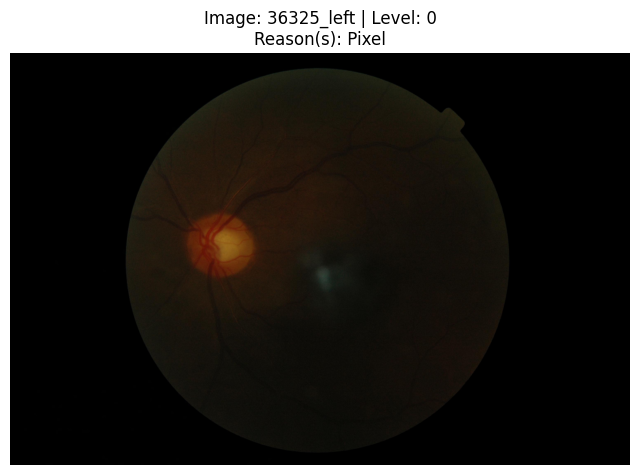

----------------------------------------


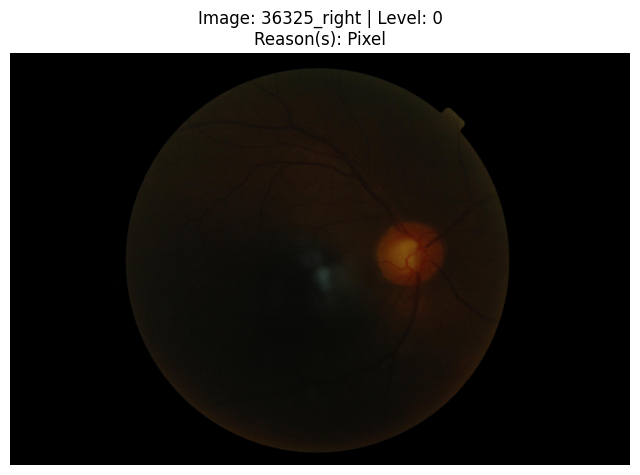

----------------------------------------


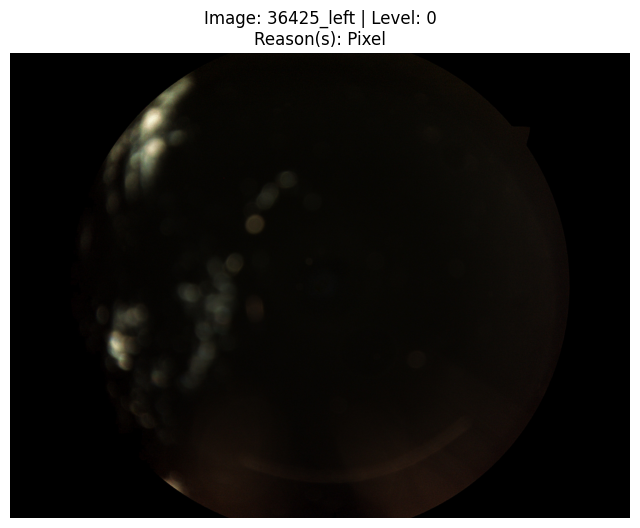

----------------------------------------


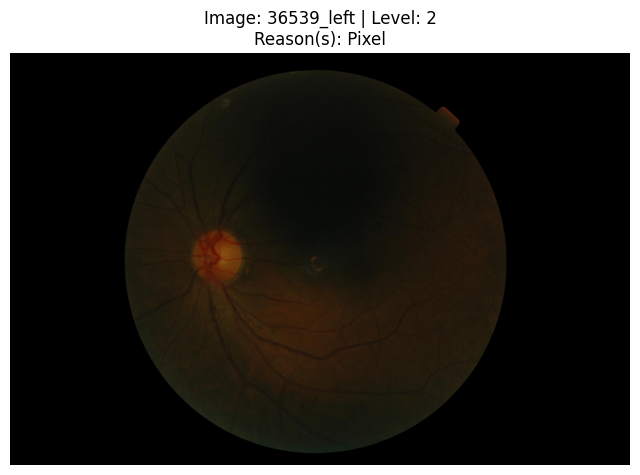

----------------------------------------


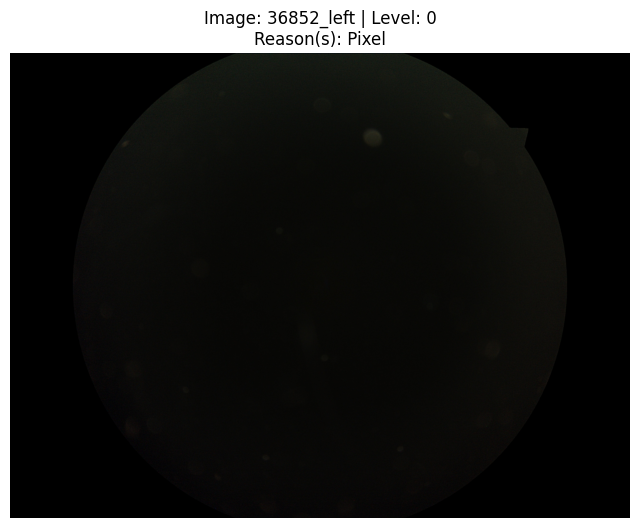

----------------------------------------


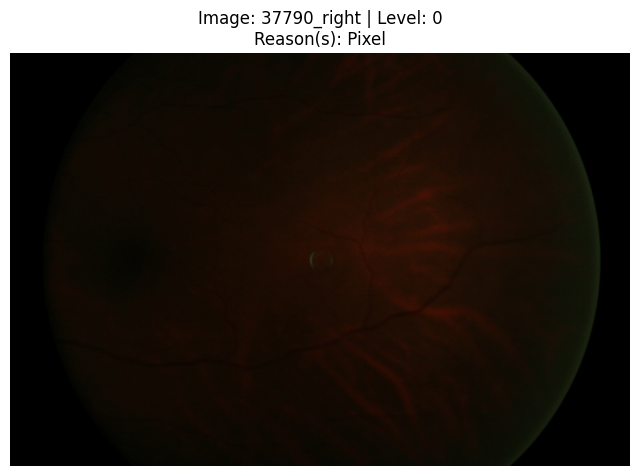

----------------------------------------


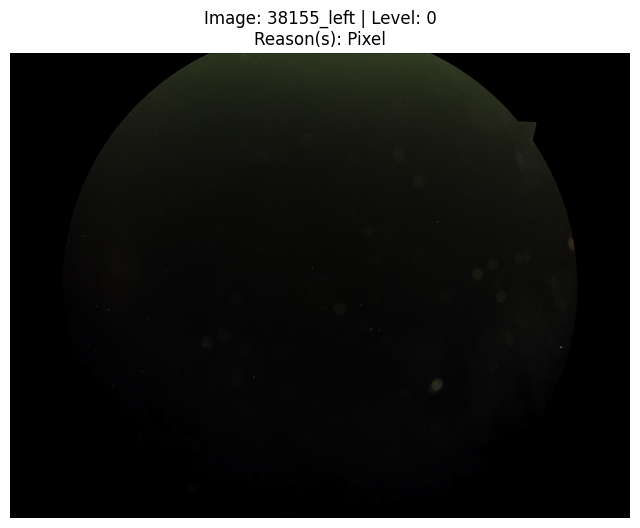

----------------------------------------


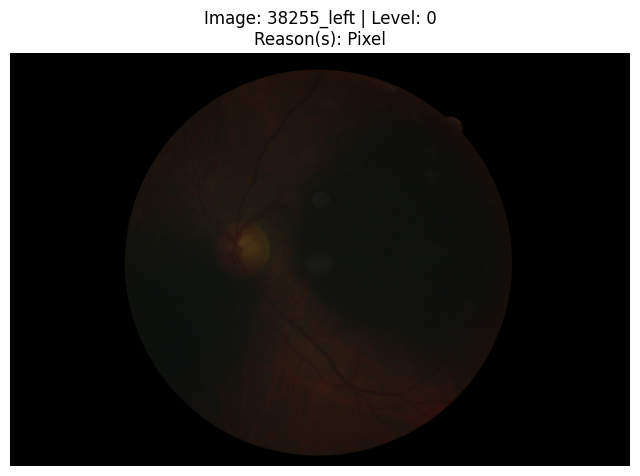

----------------------------------------


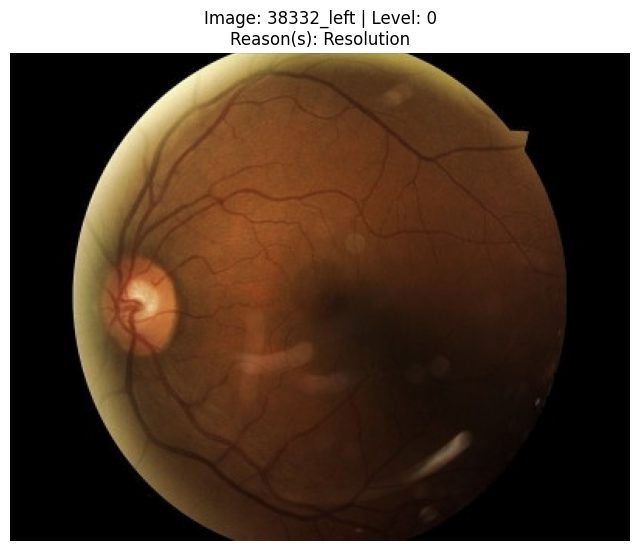

----------------------------------------


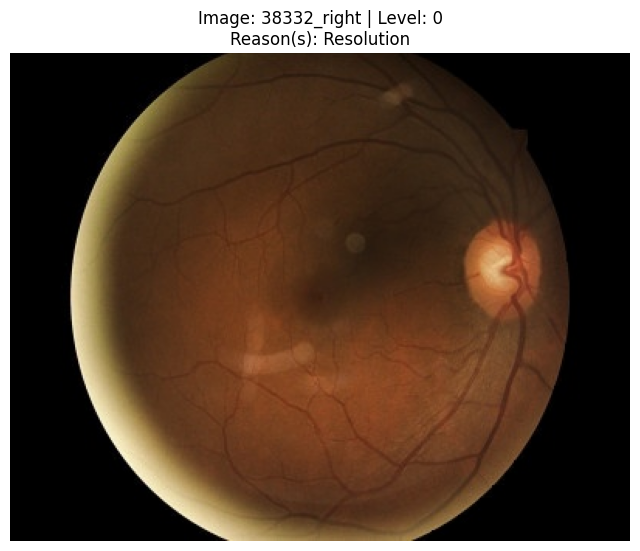

----------------------------------------


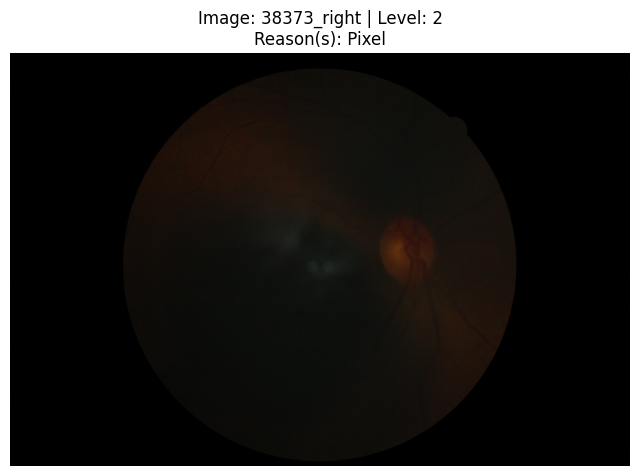

----------------------------------------


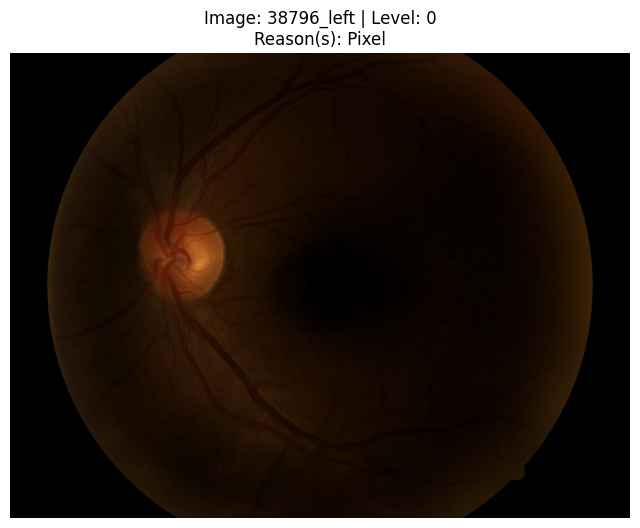

----------------------------------------


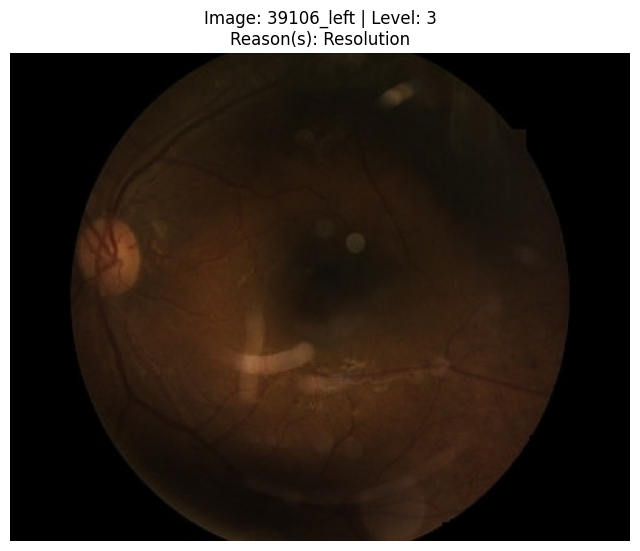

----------------------------------------


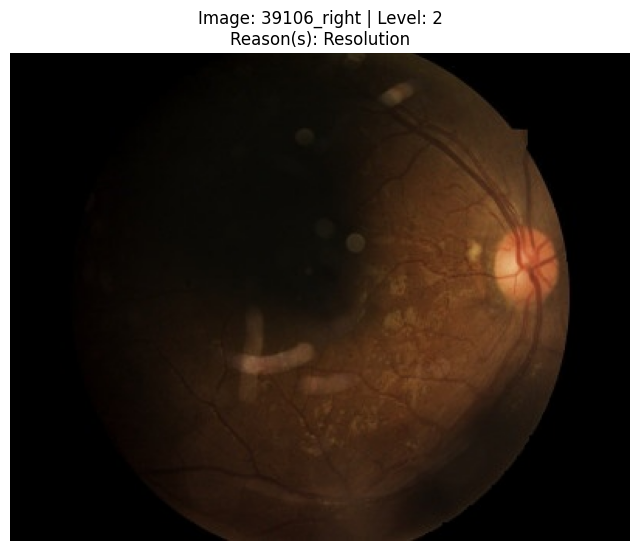

----------------------------------------


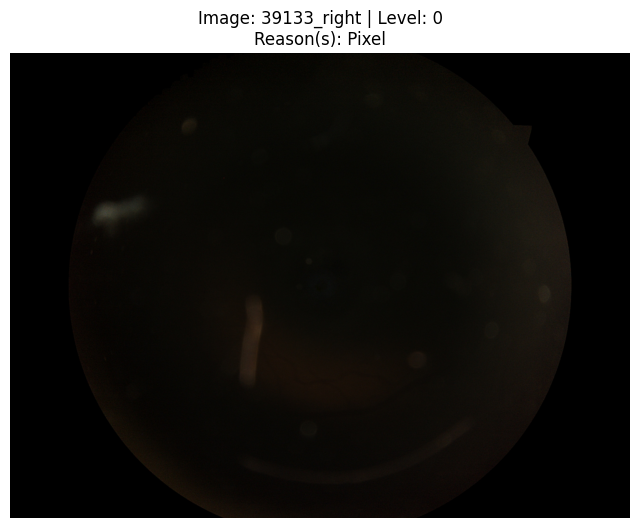

----------------------------------------


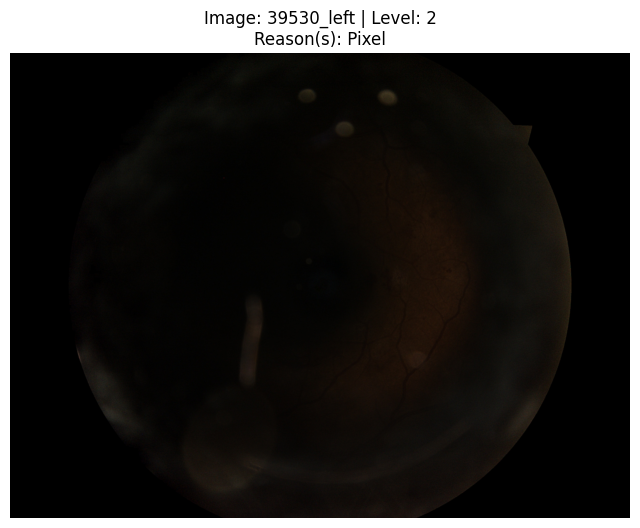

----------------------------------------


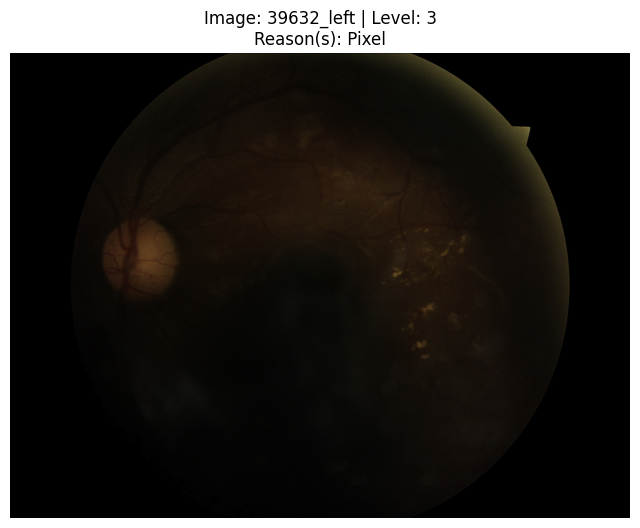

----------------------------------------


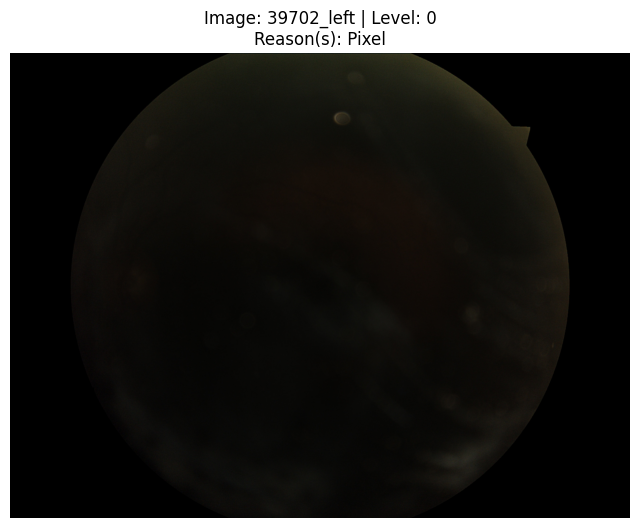

----------------------------------------


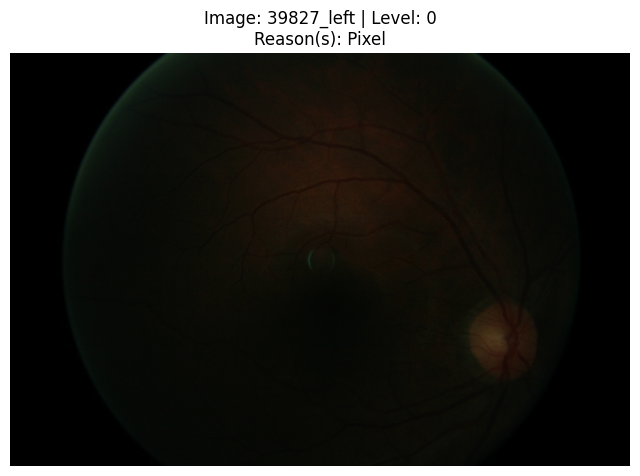

----------------------------------------


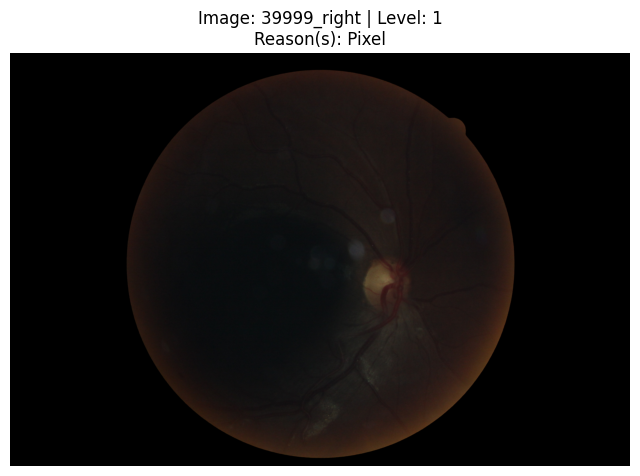

----------------------------------------


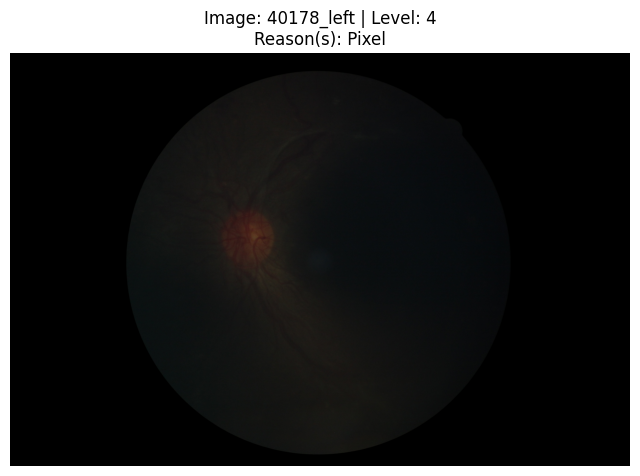

----------------------------------------


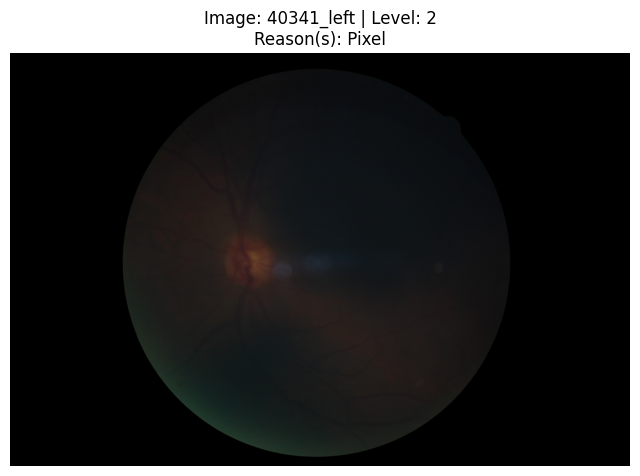

----------------------------------------


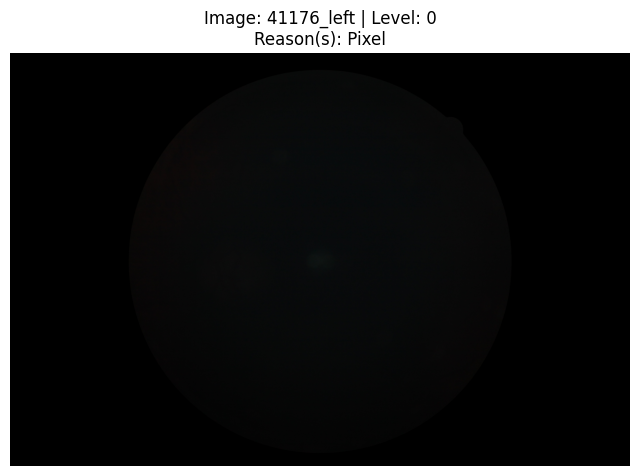

----------------------------------------


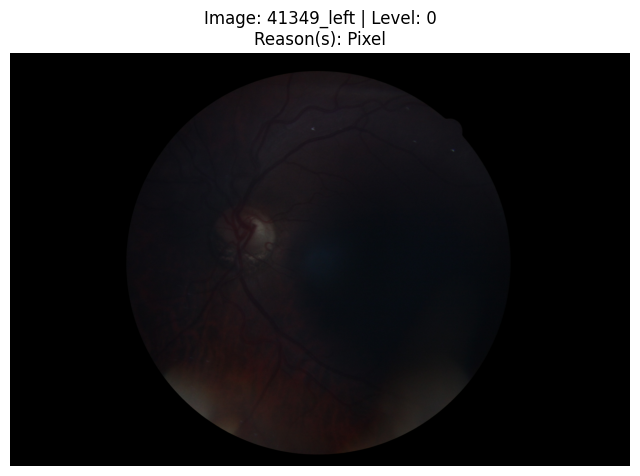

----------------------------------------


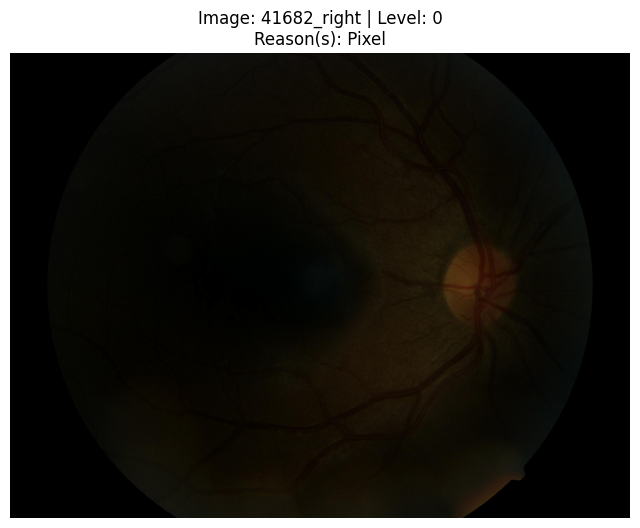

----------------------------------------


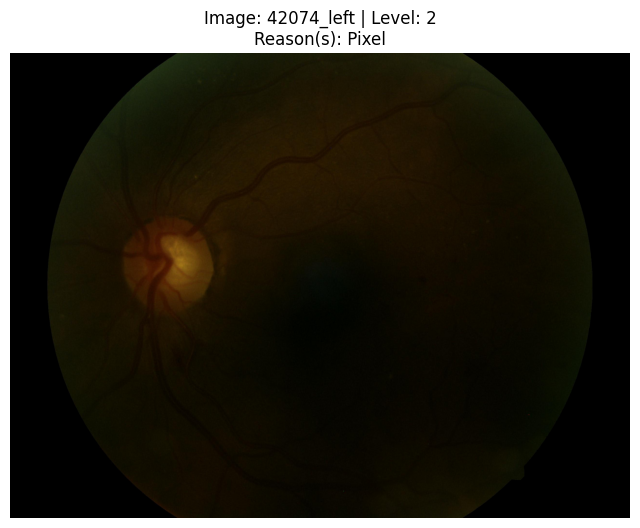

----------------------------------------


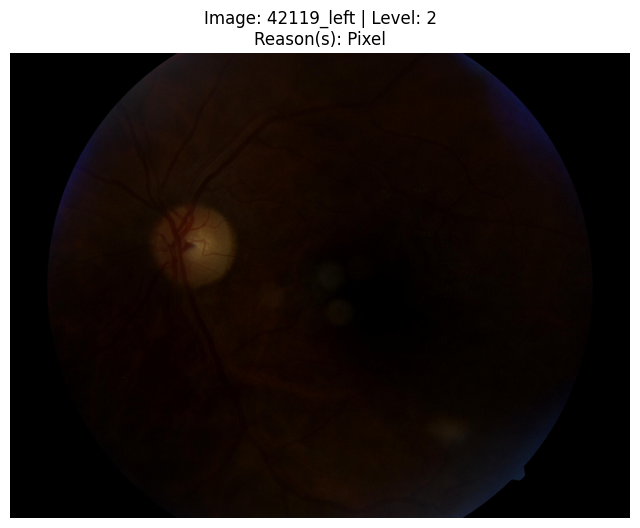

잘못된 입력입니다. k, d, u, q 중 하나를 입력하세요.
----------------------------------------


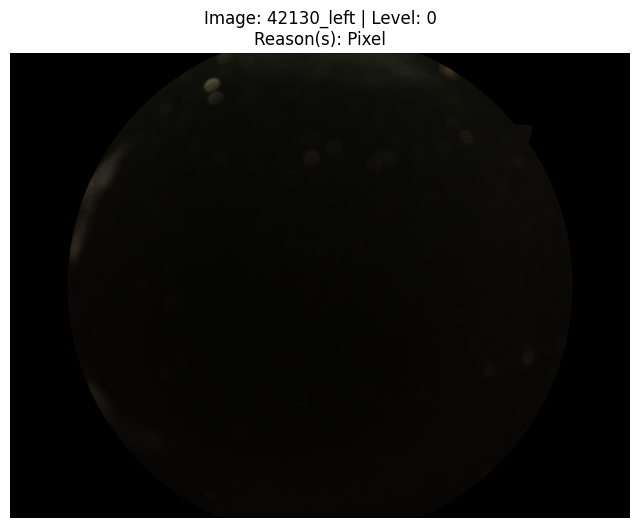

----------------------------------------


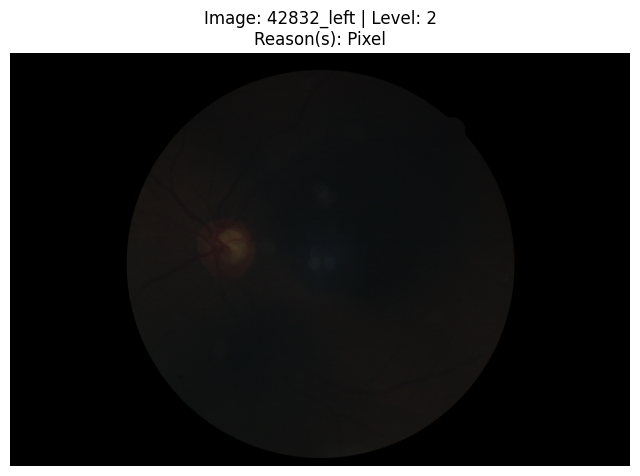

----------------------------------------


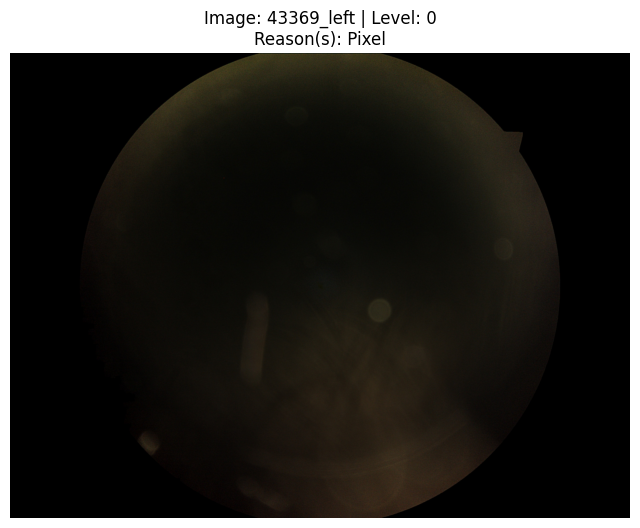

----------------------------------------


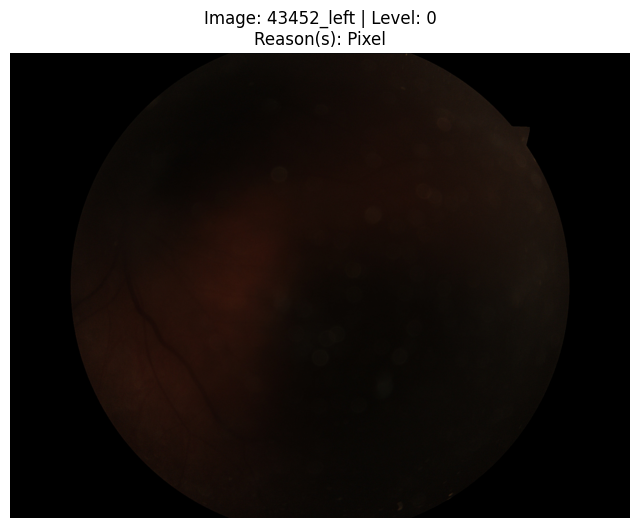

----------------------------------------


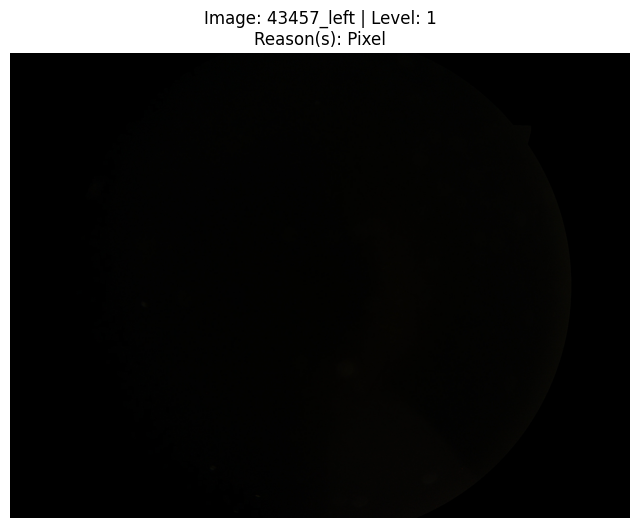

----------------------------------------


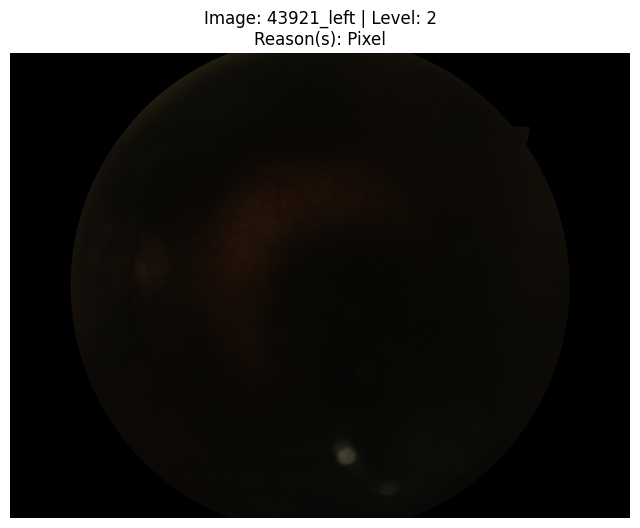

----------------------------------------


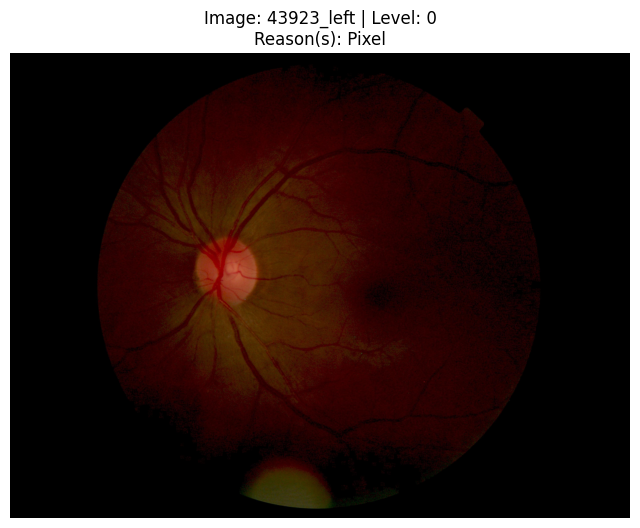

----------------------------------------


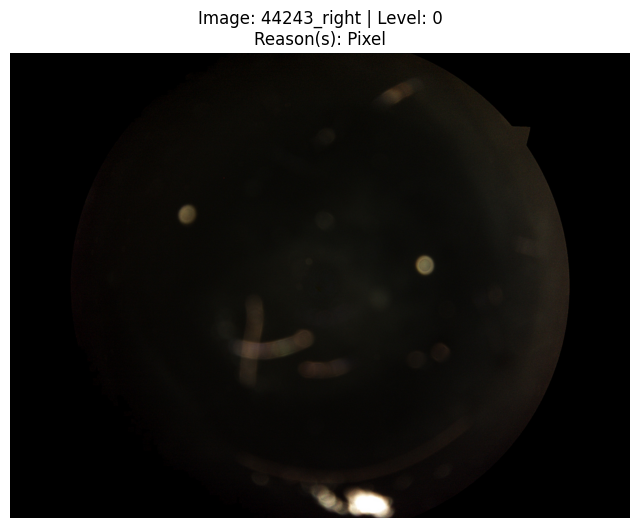

잘못된 입력입니다. k, d, u, q 중 하나를 입력하세요.
----------------------------------------
총 173개의 새로운 검토 결과가 'outlier_review_log.csv'에 저장되었습니다.


In [2]:
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import os

# 1. 이상치 후보 목록이 포함된 전체 데이터 불러오기
try:
    df = pd.read_csv('outliers_candidates.csv')
except FileNotFoundError:
    print("train.csv 파일을 찾을 수 없습니다. EDA 노트북을 실행하여 파일을 먼저 생성해주세요.")
    # 또는 df = pd.read_csv('outliers_candidates.csv') 로 변경하여 사용 가능
    exit()


# 2. 해상도 또는 픽셀 이상치만 필터링
outlier_candidates = df[(df['resolution_outlier'] == True) | (df['pixel_outlier'] == True)].copy()
print(f"총 {len(outlier_candidates)}개의 이상치 후보를 검토합니다.")


# 3. 검토 결과 기록을 위한 리스트 초기화
review_log = []
log_filename = 'outlier_review_log.csv'

# 이전에 검토한 내용이 있다면 이어서 진행
reviewed_images = set()
if os.path.exists(log_filename):
    reviewed_df = pd.read_csv(log_filename)
    reviewed_images = set(reviewed_df['image_path'])
    print(f"기존에 검토한 {len(reviewed_images)}개의 이미지를 제외하고 이어서 진행합니다.")


for idx, row in outlier_candidates.iterrows():
    
    image_path = row['image_path']
    
    # 이미 검토한 이미지는 건너뛰기
    if image_path in reviewed_images:
        continue

    # 4. 어떤 유형의 이상치인지 텍스트로 준비
    outlier_reasons = []
    if row['resolution_outlier']:
        outlier_reasons.append('Resolution')
    if row['pixel_outlier']:
        outlier_reasons.append('Pixel')
    
    reason_str = ", ".join(outlier_reasons)

    # 5. 이미지와 상세 정보 함께 보여주기
    try:
        img = Image.open(image_path)
        plt.figure(figsize=(8, 8))
        plt.imshow(img)
        plt.title(f"Image: {row['image']} | Level: {row['level']}\nReason(s): {reason_str}", fontsize=12)
        plt.axis('off')
        plt.show()
    except Exception as e:
        print(f"{row['image']} 파일을 여는 중 오류 발생: {e}")
        continue

    # 6. 터미널에서 결정 입력받기 (q로 종료)
    while True:
        decision = input("결정 (k: 유지, d: 제거, u: 판독불가, q: 저장 후 종료): ").lower()
        if decision in ['k', 'd', 'u', 'q']:
            break
        else:
            print("잘못된 입력입니다. k, d, u, q 중 하나를 입력하세요.")

    if decision == 'q':
        print("검토를 중단하고 현재까지의 기록을 저장합니다.")
        break

    # 7. 결정 기록하기
    notes = input("메모 (선택사항): ")
    review_log.append({
        'image_path': image_path,
        'original_level': row['level'],
        'outlier_reasons': reason_str,
        'decision': decision,
        'notes': notes
    })
    
    print("-" * 40)

# 8. 최종 결정 내용을 CSV 파일로 저장
if review_log:
    new_review_df = pd.DataFrame(review_log)
    if os.path.exists(log_filename):
        # 기존 로그 파일에 새로운 내용 추가
        final_log_df = pd.concat([reviewed_df, new_review_df], ignore_index=True)
    else:
        final_log_df = new_review_df
    
    final_log_df.to_csv(log_filename, index=False)
    print(f"총 {len(new_review_df)}개의 새로운 검토 결과가 '{log_filename}'에 저장되었습니다.")
else:
    print("새롭게 검토된 이미지가 없습니다.")

In [4]:
import pandas as pd
import os
import re

# ====================================================
# 데이터 정제 스크립트 (사용자 파일 구조 맞춤 수정본)
# ====================================================

def get_image_key_from_path(path_str):
    """
    'data/images/trainW1557_right.jpeg'와 같은 전체 경로에서
    '1557_right'와 같은 핵심 이미지 키를 추출합니다.
    """
    try:
        # 1. 파일 이름만 추출: 'trainW1557_right.jpeg'
        basename = os.path.basename(path_str)
        # 2. 확장자 제거: 'trainW1557_right'
        name_without_ext = os.path.splitext(basename)[0]
        # 3. 'trainW' 같은 접두사 제거: '1557_right' (정규식 사용)
        key = re.sub(r'^[a-zA-Z]+', '', name_without_ext)
        return key
    except:
        return None

try:
    # 1. CSV 파일 불러오기
    train_csv_path = 'train.csv'
    outlier_log_path = 'outlier_review_log.csv'
    
    if not os.path.exists(train_csv_path):
        raise FileNotFoundError(f"'{train_csv_path}' 파일을 찾을 수 없습니다.")
    if not os.path.exists(outlier_log_path):
        raise FileNotFoundError(f"'{outlier_log_path}' 파일을 찾을 수 없습니다.")

    train_df = pd.read_csv(train_csv_path)
    outlier_log_df = pd.read_csv(outlier_log_path)
    
    print("CSV 파일들을 성공적으로 불러왔습니다.")
    print(f"   - 원본 train.csv 데이터 수: {len(train_df)}")
    print(f"   - 이상치 검토 로그 데이터 수: {len(outlier_log_df)}")

    # 2. 삭제할 이미지 목록 생성
    # 'decision' 컬럼에서 'd' (삭제)로 표시된 행들을 선택합니다.
    rows_to_delete = outlier_log_df[outlier_log_df['decision'] == 'd']
    
    # 각 행의 'image_path'에서 핵심 키를 추출하여 삭제 목록을 만듭니다.
    keys_to_delete = set(rows_to_delete['image_path'].apply(get_image_key_from_path))
    
    print(f"\n삭제할 이미지 개수 ('d'로 표시): {len(keys_to_delete)}")

    # 'k' (유지)로 표시된 이미지 ID 목록 확인
    rows_to_keep = outlier_log_df[outlier_log_df['decision'] == 'k']
    keys_to_keep = set(rows_to_keep['image_path'].apply(get_image_key_from_path))
    print(f"밝기 조절 후 사용할 이미지 개수 ('k'로 표시): {len(keys_to_keep)}")

    # 3. 원본 데이터프레임 필터링
    # train_df의 'image' 컬럼 값이 삭제 목록(keys_to_delete)에 포함되지 않은 행만 남깁니다.
    original_rows = len(train_df)
    cleaned_train_df = train_df[~train_df['image'].isin(keys_to_delete)].copy()
    
    print(f"\n원본 {original_rows}개 중 {original_rows - len(cleaned_train_df)}개를 제거했습니다.")
    print(f"   최종 데이터 수: {len(cleaned_train_df)}")

    # 4. 정제된 데이터 저장
    output_filename = 'train_cleaned.csv'
    cleaned_train_df.to_csv(output_filename, index=False)
    
    print("\n작업 완료!")
    print(f"정제된 데이터가 '{output_filename}' 파일로 저장되었습니다.")
    print("이제부터 이 파일을 모델 학습에 사용하시면 됩니다.")

except FileNotFoundError as e:
    print(f"오류: {e}")
except KeyError as e:
    print(f"오류: CSV 파일의 컬럼명이 코드와 일치하는지 확인해주세요. (예상과 다른 컬럼: {e})")
except Exception as e:
    print(f"예상치 못한 오류가 발생했습니다: {e}")

CSV 파일들을 성공적으로 불러왔습니다.
   - 원본 train.csv 데이터 수: 35126
   - 이상치 검토 로그 데이터 수: 173

삭제할 이미지 개수 ('d'로 표시): 59
밝기 조절 후 사용할 이미지 개수 ('k'로 표시): 114

원본 35126개 중 59개를 제거했습니다.
   최종 데이터 수: 35067

작업 완료!
정제된 데이터가 'train_cleaned.csv' 파일로 저장되었습니다.
이제부터 이 파일을 모델 학습에 사용하시면 됩니다.
